# A comparison of the performance of Koopman versus the Vanilla benchmark
Tested on one month in 2017 for all zones. Trained on the 11 preceding years. Then a 52 day gap. Then tested for one month.

In [1]:
import torch
import random
import numpy as np
import pandas as pd
import numpy.matlib
import matplotlib.pyplot as plt
%matplotlib inline
from datetime import datetime
from scipy.stats import norm, skewnorm, skew
from sklearn import linear_model

%load_ext autoreload
%autoreload 2

In [2]:
seed = 633

print("[ Using Seed : ", seed, " ]")

torch.manual_seed(seed)
torch.cuda.manual_seed_all(seed)
torch.cuda.manual_seed(seed)
numpy.random.seed(seed)
random.seed(seed)
torch.backends.cudnn.deterministic = True
torch.backends.cudnn.benchmark = False

[ Using Seed :  633  ]


In [3]:
from koopman_probabilistic import KoopmanProb
from model_objs import SkewNLLwithTime
import vanilla_benchmark

## Pinball Loss

In [4]:
def skew_pinball_loss(data, mus, sigmas, alphas, quantiles=range(10, 100, 10)):
    assert(len(data) == len(mus))
    loss = 0
    for i in range(len(data)):
        for q in quantiles:
            q = q / 100
            quant_pred = skewnorm.ppf(q, alphas[i], loc=mus[i], scale=sigmas[i])
            if quant_pred > data[i]:
                loss += (quant_pred - data[i]) * (1 - q)
            else:
                loss += (data[i] - quant_pred) * q
    return loss / (len(data) * len(quantiles))

In [5]:
normal_pdf = lambda mu, sigma, x: np.exp(-(x - mu)**2 / (2 * sigma**2))/(np.sqrt(2 * np.pi * sigma**2))

In [6]:
def rms(x, axis=None):
    if axis is not None:
        return np.sqrt(np.sum(x**2, axis=axis) / x.shape[axis])
    return np.sqrt(np.sum(x**2) / x.size)

# load data

In [7]:
import json

with open("GEFCom2017\\GEFCom2017-Qual\\GEFCom2017QualAll.json") as f:
    all_data = json.loads(f.read())

In [8]:
dates = np.array(list(map(pd.Timestamp, all_data["ISONE CA"]["Date"])))
zones = list(all_data.keys())
print(zones)

['ISONE CA', 'ME', 'RI', 'VT', 'CT', 'NH', 'SEMASS', 'WCMASS', 'NEMASSBOST']


# SELECT A MONTH TO TEST FOR ALL ZONES

In [9]:
month_name = "Feb"  # <<<< CHOOSE A MONTH
months = ["Jan", "Feb", "Mar", "Apr", "May", "Jun", "Jul", "Aug", "Sep", "Oct", "Nov", "Dec"]
month_idx = months.index(month_name)
print("Testing on month", months[month_idx])
test_start_date = pd.Timestamp(f"2017-{month_idx + 1}-01 00:00:00")
test_start = np.argwhere(dates == test_start_date)[0, 0]
test_length = 31 * 24

Testing on month Feb


In [10]:
delay_delta = pd.Timedelta(days=52)
delay = delay_delta.days * 24
train_end_date = test_start_date - delay_delta
train_start_date = train_end_date.replace(year=train_end_date.year - 11)
train_start = np.argwhere(dates == train_start_date)[0, 0]
train_length_delta = train_end_date - train_start_date
train_through = train_length_delta.days * 24
year_length = 365.24 * 24

## Vanilla Benchmark Forecast

In [11]:
# test_start_dates = np.array(list(pd.Timestamp(f"2017-{month_idx + 1}-01 00:00:00") for month_idx in range(12)))
# train_end_dates = test_start_dates - delay_delta
# train_start_dates = list(end_date.replace(year=end_date.year - 11) for end_date in train_end_dates)
# vanilla_losses = dict()
# for zone_name in zones:
#     print("\n\nZONE:", zone_name)
#     vanilla_losses[zone_name] = []
#     for i, start_date in enumerate(train_start_dates):
#         print("testing on ", test_start_dates[i])
#         loss = vanilla_benchmark.get_lossesGEFCom(11, 31 * 24, start_date=start_date, zones=[zone_name],
#                               delay_days=delay_delta.days, plot=True)[zone_name]
#         vanilla_losses[zone_name].append(loss)
# vanilla_losses = pd.DataFrame(vanilla_losses)
# vanilla_losses["month"] = months
# vanilla_losses.to_pickle("experiments/vanilla_comp/vanilla_losses.pkl")

In [12]:
vanilla_losses = pd.read_pickle("experiments/vanilla_comp/vanilla_losses.pkl")
vanilla_losses

,ISONE CA,ME,RI,VT,CT,NH,SEMASS,WCMASS,NEMASSBOST,month
0,404.322538,28.991850,24.618092,22.845517,111.554248,35.415269,50.740262,53.850633,87.172277,Jan
1,439.179119,26.549788,27.877621,17.255753,123.341719,35.329907,61.419992,68.035331,93.743314,Feb
2,439.287499,30.992815,26.380057,24.916715,124.686462,39.072709,59.444736,64.583227,81.282889,Mar
3,262.884347,20.612047,14.836730,21.163325,68.654486,21.590003,43.379982,42.282122,50.873588,Apr
4,356.395186,18.106734,22.525307,19.104377,100.539436,29.380237,47.583941,50.520075,84.747712,May
5,650.644480,30.527894,49.153483,20.684217,196.820537,61.139079,83.553166,85.789486,137.700936,Jun
6,843.225606,40.885764,67.516006,23.722510,255.539877,74.751605,121.826118,99.725100,166.959261,Jul
7,679.210605,34.857085,53.938752,23.438780,203.212347,62.246838,98.558831,79.677067,122.551463,Aug
8,582.748297,26.458070,44.599208,23.597283,174.059924,50.764932,71.265011,80.771020,117.905531,Sep
9,295.836348,30.924309,21.041674,20.086118,77.079370,27.901953,42.660221,38.373114,61.924065,Oct


# Forecasting mean, variance, and skewness of Skew-Normal distribution

In [13]:
%matplotlib inline
z_scores = []
test_z_scores = []
losses = []
relative_perfs = []

ZONE: ISONE CA
data (113952, 1)
x (98424, 1)
xt (96432, 1)
fourier periods: tensor([  24.0000,  168.0000, 8765.7598], dtype=torch.float64)
Loss at iteration 10: -1.7162795806121347
Loss at iteration 60: -1.8544971649438389
THIS BATCH USING LOG CDF APPROXIMATION (large z-score can otherwise cause numerical instability)
THIS BATCH USING LOG CDF APPROXIMATION (large z-score can otherwise cause numerical instability)
THIS BATCH USING LOG CDF APPROXIMATION (large z-score can otherwise cause numerical instability)
THIS BATCH USING LOG CDF APPROXIMATION (large z-score can otherwise cause numerical instability)
THIS BATCH USING LOG CDF APPROXIMATION (large z-score can otherwise cause numerical instability)
THIS BATCH USING LOG CDF APPROXIMATION (large z-score can otherwise cause numerical instability)
THIS BATCH USING LOG CDF APPROXIMATION (large z-score can otherwise cause numerical instability)
THIS BATCH USING LOG CDF APPROXIMATION (large z-score can otherwise cause numerical instability)
T

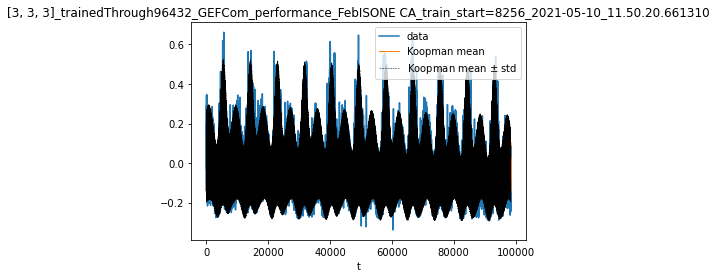

actual overall mean: 0.0006984590971903803  predicted mean: 0.003374477
actual mu train mean: 0.0006984590971903803  predicted mean: 0.003374477
mean test z-score: -0.941805106401922
std test z-score: 0.8339513388986981


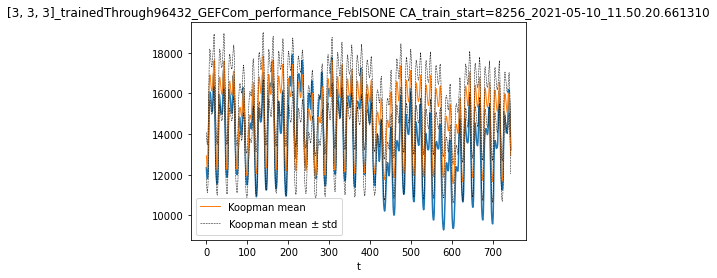

pinball_loss: 433.6121563592411
1.2675837415280666% performance relative to vanilla benchmark





ZONE: ME
data (113952, 1)
x (98424, 1)
xt (96432, 1)
fourier periods: tensor([  24.0000,  168.0000, 8765.7598], dtype=torch.float64)
Loss at iteration 10: -1.6735744454566128
Loss at iteration 60: -1.7632059377302527
Loss at iteration 110: -1.7922329702127355
Final loss: -1.796289558740769


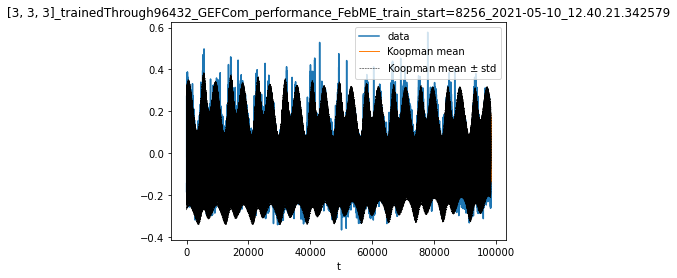

actual overall mean: -0.0014046571267071755  predicted mean: 0.0025335618
actual mu train mean: -0.0014046571267071755  predicted mean: 0.0025335618
mean test z-score: -0.7563613213903628
std test z-score: 0.8497012114981852


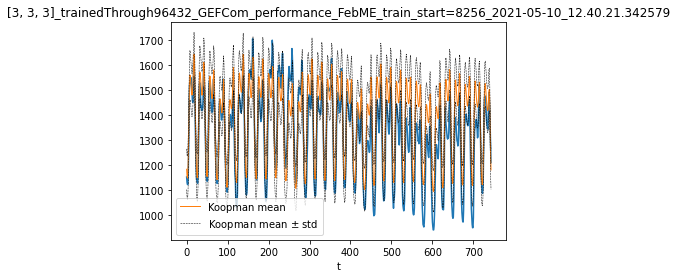

pinball_loss: 31.030810468282745
-16.877808945893857% performance relative to vanilla benchmark





ZONE: RI
data (113952, 1)
x (98424, 1)
xt (96432, 1)
fourier periods: tensor([  24.0000,  168.0000, 8765.7598], dtype=torch.float64)
Loss at iteration 10: -1.85976647970142
Loss at iteration 60: -2.0343463772664245
Loss at iteration 110: -2.0744636587745933
Final loss: -2.08192787344455


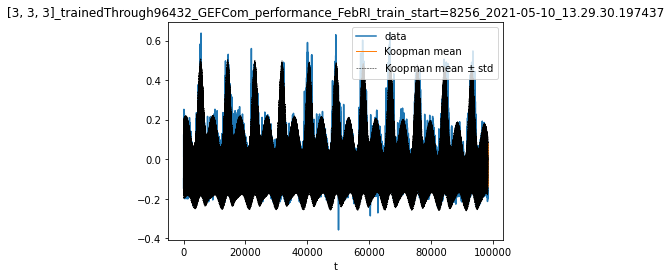

actual overall mean: 0.0004530218550664056  predicted mean: -0.0023670464
actual mu train mean: 0.0004530218550664056  predicted mean: -0.0023670464
mean test z-score: -0.7192776730381687
std test z-score: 0.7512683002257647


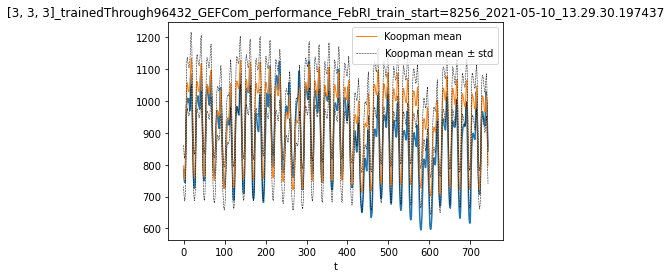

pinball_loss: 22.255914514575217
20.165660401936623% performance relative to vanilla benchmark





ZONE: VT
data (113952, 1)
x (98424, 1)
xt (96432, 1)
fourier periods: tensor([  24.0000,  168.0000, 8765.7598], dtype=torch.float64)
Loss at iteration 10: -1.570976766276946
Loss at iteration 60: -1.6729074810202842
Loss at iteration 110: -1.7049653713251773
Final loss: -1.7100665532913304


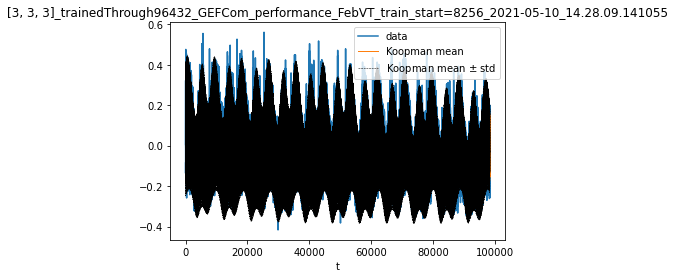

actual overall mean: 0.0025364637786270175  predicted mean: -0.0018832553
actual mu train mean: 0.0025364637786270175  predicted mean: -0.0018832553
mean test z-score: -0.6183113997165223
std test z-score: 0.9038242492680737


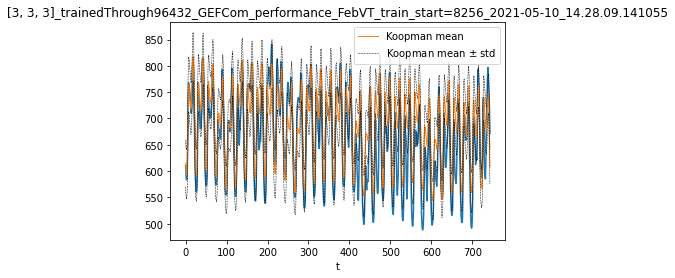

pinball_loss: 14.392219669696829
16.594659412245115% performance relative to vanilla benchmark





ZONE: CT
data (113952, 1)
x (98424, 1)
xt (96432, 1)
fourier periods: tensor([  24.0000,  168.0000, 8765.7598], dtype=torch.float64)
Loss at iteration 10: -1.7724547235063803
Loss at iteration 60: -1.9018269929955793
THIS BATCH USING LOG CDF APPROXIMATION (large z-score can otherwise cause numerical instability)
THIS BATCH USING LOG CDF APPROXIMATION (large z-score can otherwise cause numerical instability)
THIS BATCH USING LOG CDF APPROXIMATION (large z-score can otherwise cause numerical instability)
THIS BATCH USING LOG CDF APPROXIMATION (large z-score can otherwise cause numerical instability)
THIS BATCH USING LOG CDF APPROXIMATION (large z-score can otherwise cause numerical instability)
THIS BATCH USING LOG CDF APPROXIMATION (large z-score can otherwise cause numerical instability)
THIS BATCH USING LOG CDF APPROXIMATION (large z-score can otherwise cause numerical instability)
THIS

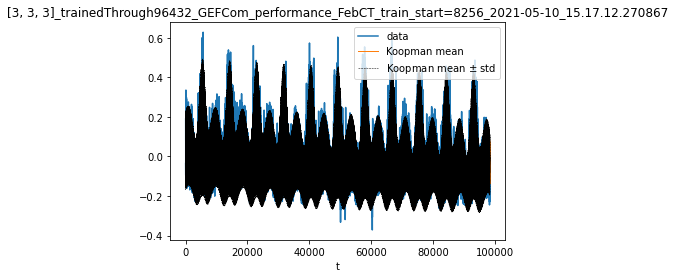

actual overall mean: -0.0003925873335304058  predicted mean: -0.0059213843
actual mu train mean: -0.0003925873335304058  predicted mean: -0.0059213843
mean test z-score: -0.779604927072391
std test z-score: 0.7183967752174232


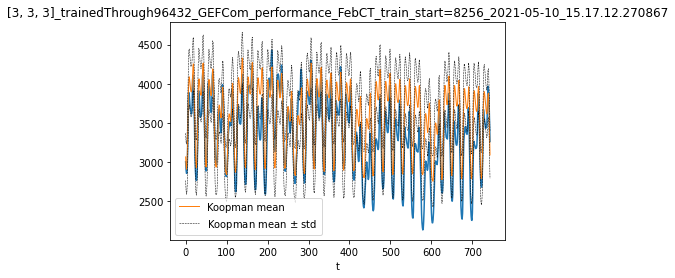

pinball_loss: 106.07795820704517
13.996692108346675% performance relative to vanilla benchmark





ZONE: NH
data (113952, 1)
x (98424, 1)
xt (96432, 1)
fourier periods: tensor([  24.0000,  168.0000, 8765.7598], dtype=torch.float64)
Loss at iteration 10: -1.778090574352554
Loss at iteration 60: -1.9191403598906946
Loss at iteration 110: -1.9517754293303808
Final loss: -1.954753330730113


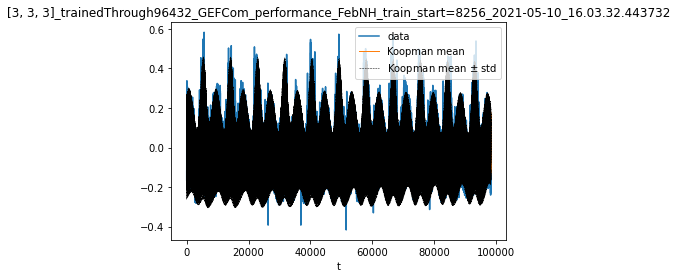

actual overall mean: 2.051770151083492e-05  predicted mean: 8.2506354e-05
actual mu train mean: 2.051770151083492e-05  predicted mean: 8.2506354e-05
mean test z-score: -0.9699205321564107
std test z-score: 0.8943813773034677


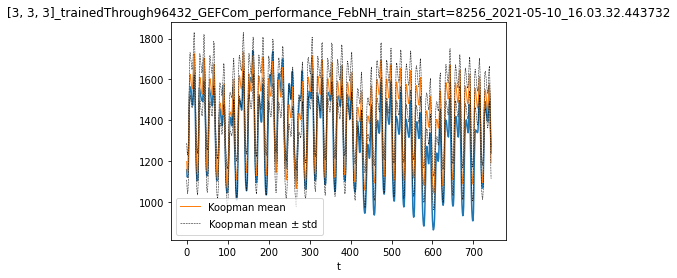

pinball_loss: 38.12165732380339
-7.901945757770168% performance relative to vanilla benchmark





ZONE: SEMASS
data (113952, 1)
x (98424, 1)
xt (96432, 1)
fourier periods: tensor([  24.0000,  168.0000, 8765.7598], dtype=torch.float64)
Loss at iteration 10: -1.8319162636052022
Loss at iteration 60: -2.0197644798889254
THIS BATCH USING LOG CDF APPROXIMATION (large z-score can otherwise cause numerical instability)
THIS BATCH USING LOG CDF APPROXIMATION (large z-score can otherwise cause numerical instability)
THIS BATCH USING LOG CDF APPROXIMATION (large z-score can otherwise cause numerical instability)
THIS BATCH USING LOG CDF APPROXIMATION (large z-score can otherwise cause numerical instability)
THIS BATCH USING LOG CDF APPROXIMATION (large z-score can otherwise cause numerical instability)
THIS BATCH USING LOG CDF APPROXIMATION (large z-score can otherwise cause numerical instability)
THIS BATCH USING LOG CDF APPROXIMATION (large z-score can otherwise cause numerical instability)
T

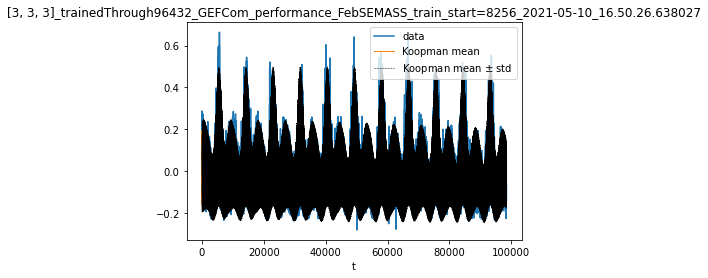

actual overall mean: 0.0008308714834075767  predicted mean: 0.002488094
actual mu train mean: 0.0008308714834075767  predicted mean: 0.002488094
mean test z-score: -0.8577660374817138
std test z-score: 0.8641829385187201


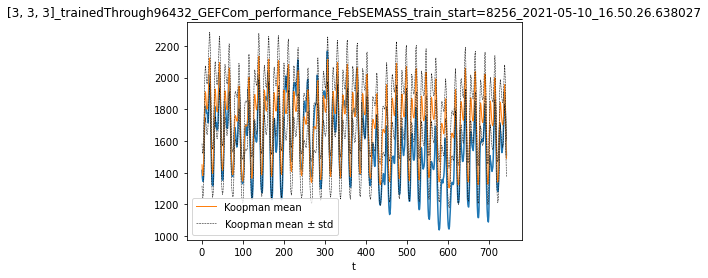

pinball_loss: 54.569398927823514
11.153686101122318% performance relative to vanilla benchmark





ZONE: WCMASS
data (113952, 1)
x (98424, 1)
xt (96432, 1)
fourier periods: tensor([  24.0000,  168.0000, 8765.7598], dtype=torch.float64)
Loss at iteration 10: -1.7527304387264495
Loss at iteration 60: -1.872537317970233
Loss at iteration 110: -1.9078026105423918
Final loss: -1.9128866120536634


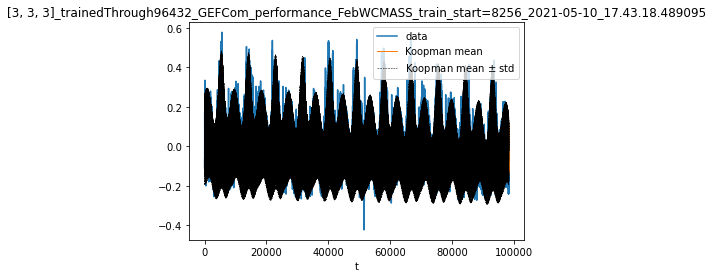

actual overall mean: 0.0005982755136395982  predicted mean: 0.0026328189
actual mu train mean: 0.0005982755136395982  predicted mean: 0.0026328189
mean test z-score: -0.8511345399111214
std test z-score: 0.8381380201194221


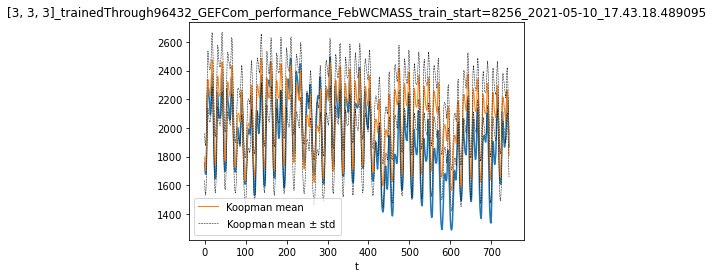

pinball_loss: 61.50259435719814
9.601977283748342% performance relative to vanilla benchmark





ZONE: NEMASSBOST
data (113952, 1)
x (98424, 1)
xt (96432, 1)
fourier periods: tensor([  24.0000,  168.0000, 8765.7598], dtype=torch.float64)
Loss at iteration 10: -1.651835193795708
Loss at iteration 60: -1.8052516272238264
Loss at iteration 110: -1.865363710152382
Final loss: -1.8718309995025508


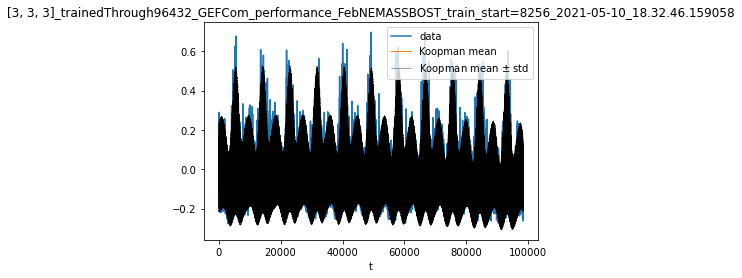

actual overall mean: 0.0029085156491708663  predicted mean: 0.0032767174
actual mu train mean: 0.0029085156491708663  predicted mean: 0.0032767174
mean test z-score: -0.7837940319987533
std test z-score: 0.892890461442738


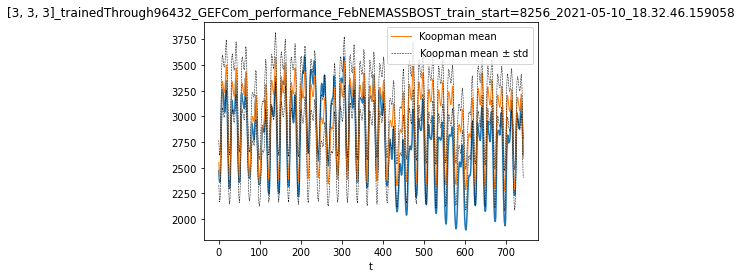

pinball_loss: 81.34056644796416
13.2305406927283% performance relative to vanilla benchmark







In [14]:
for zone_name in zones:
    print("ZONE:", zone_name)
    data = np.array([all_data[zone_name]["DEMAND"]], dtype=np.float64).T
    
    # rescale data
    x_original = data
    mean = np.mean(data, axis=0)
    rnge = np.max(data, axis=0) - np.min(data, axis=0)
    data = (data - np.matlib.repmat(mean, data.shape[0], 1)) / np.matlib.repmat(rnge, data.shape[0], 1)
    print("data", data.shape)

    predict_through = train_through + delay + test_length
    x = data[train_start:][:predict_through]
    xt = x[:train_through]
    
    mask = None
    num_freqs = [3, 3, 3]
    num_fourier = 3
    loss_weights = 1 + 0.4 * torch.cos(torch.linspace(0, 11 * 2 * np.pi, xt.shape[0]) - 2 * np.pi * (delay + test_length / 2) / year_length)
    recency_weights = 1/(1 + torch.exp((3*xt.shape[0] / 4 - torch.arange(xt.shape[0])) / (xt.shape[0] / 10))) + 0.747
    loss_weights *= recency_weights
    print("x", x.shape)
    print("xt", xt.shape)

    now = ("_".join(str(datetime.now()).split())).replace(":", ".")

    ### TRAIN ###
    model = SkewNLLwithTime(x_dim=xt.shape[1], num_freqs=num_freqs, n=256)
    k = KoopmanProb(model, device='cpu', sample_num=24, num_fourier_modes=num_fourier, batch_size=32, loss_weights=loss_weights)

    k.find_fourier_omegas(xt, hard_code=[24, 168, 24 * 365.24])
    data_name = "GEFCom_performance_" + months[month_idx] + zone_name + f"_train_start={train_start}_" + now

    k.fit(xt, iterations=120, verbose=False, cutoff=0, weight_decay=1e-3, lr_theta=1e-4, lr_omega=0, training_mask=mask);

    fname = "experiments\\vanilla_comp\\" + data_name + f"trained{train_start}-{train_through}_"
    mu_file = fname + "mu.npy"
    sigma_file = fname + "sigma.npy"
    alpha_file = fname + "alpha.npy"    

    ### FORECAST ###
    params = k.predict(predict_through)
    mu_hat, sigma_hat, a_hat = params    
    
    np.save(mu_file, mu_hat)
    np.save(sigma_file, sigma_hat)
    np.save(alpha_file, a_hat)

    mean_hat = model.mean(params)
    std_hat = model.std(params)

    dim = 0
    plt.figure()
    # plt.scatter(np.arange(-slc), x[slc:], label="data")
    plt.plot(x[:predict_through, dim], label="data")
    plt.plot(mean_hat[:, dim], label="Koopman mean", linewidth=1)
    plt.plot(mean_hat[:, dim] + std_hat[:, dim], "--", color="black", label="Koopman mean $\pm$ std", linewidth=0.5)
    plt.plot(mean_hat[:, dim] - std_hat[:, dim], "--", color="black", linewidth=0.5)
    #plt.plot(a_hat[:, dim], color="red", linewidth=0.3, label="Koopman $\\alpha$")
    #plt.plot(std_hat[:, dim], color="green", linewidth=0.7, label="Koopman std")

    plt.title(f"{num_freqs}_trainedThrough{train_through}_" + data_name)
    plt.xlabel("t")
    plt.legend()
    plt.show()

    ### ANALYTICS ###
    print("actual overall mean:", np.mean(xt), " predicted mean:", np.mean(mean_hat[:train_through]))
    print("actual mu train mean:", np.mean(xt), " predicted mean:", np.mean(mean_hat[:train_through]))

    z_scores.append((x[:train_through] - mean_hat[:train_through]) / std_hat[:train_through])
    test_z_scores.append(
        (x[train_through + delay:predict_through] - mean_hat[train_through + delay:predict_through]) 
         / std_hat[train_through + delay:predict_through])
    print("mean test z-score:", np.mean(test_z_scores[-1]))
    print("std test z-score:", np.std(test_z_scores[-1]))

    ### PERFORMANCE ###

    #Skew-Normal distribution Rescaling to de-normalize data because pinball loss is not scale-invariant
    test_start = train_through + delay
    sigh, ah = sigma_hat[test_start: predict_through], a_hat[test_start: predict_through]
    delta = ah / np.sqrt(1 + ah ** 2)
    muh = mu_hat[test_start: predict_through] * rnge + (rnge - 1) * delta * sigh * np.sqrt(2 / np.pi)
    muh = muh + mean - (rnge - 1) * delta * sigh * np.sqrt(2 / np.pi)
    sigh = sigh * rnge
    mean_hat = model.mean([muh, sigh, ah])
    std_hat = model.std([muh, sigh, ah])

    plt.figure()
    plt.plot(x_original[train_start:][test_start: predict_through])
    plt.plot(mean_hat[:, dim], label="Koopman mean", linewidth=1)
    plt.plot(mean_hat[:, dim] + std_hat[:, dim], "--", color="black", label="Koopman mean $\pm$ std", linewidth=0.5)
    plt.plot(mean_hat[:, dim] - std_hat[:, dim], "--", color="black", linewidth=0.5)
    # plt.plot(ah[:, dim], color="red", linewidth=0.3, label="Koopman $\\alpha$")
    # plt.plot(std_hat[:, dim], color="green", linewidth=0.7, label="Koopman std")
    plt.title(f"{num_freqs}_trainedThrough{train_through}_" + data_name)
    plt.xlabel("t")
    plt.legend()
    plt.show()

    loss = skew_pinball_loss(x_original[train_start:][test_start: predict_through], muh, sigh, ah)[0]
    relative = (1 - loss/vanilla_losses[zone_name].iloc[month_idx]) * 100
    print("pinball_loss:", loss)
    print(f"{relative}% performance relative to vanilla benchmark" + "\n"*5)
    losses.append(loss)
    relative_perfs.append(relative)

# Figures

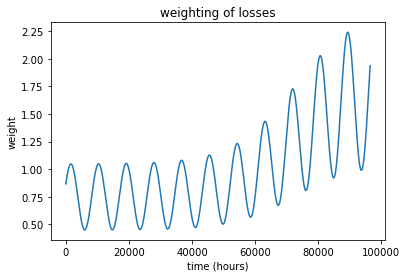

Accounts for recency and how close to the testing time of year it is.
The recency effect is ignored for the portion of the training set that is not seen by mu.


In [15]:
plt.figure()
plt.plot(loss_weights)
plt.title("weighting of losses")
plt.ylabel("weight")
plt.xlabel("time (hours)")
plt.show()
print("Accounts for recency and how close to the testing time of year it is.\nThe recency effect is ignored for the portion of the training set that is not seen by mu.")

In [16]:
z_scores = np.array(z_scores)
test_z_scores = np.array(test_z_scores)
losses = np.array(losses)
relative = np.array(relative_perfs)

In [17]:
np.save("experiments\\vanilla_comp\\" + data_name + "z_scores.npy", z_scores)
np.save("experiments\\vanilla_comp\\" + data_name + "test_z_scores.npy", test_z_scores)
np.save("experiments\\vanilla_comp\\" + data_name + "relative_perfs.npy", relative_perfs)
np.save("experiments\\vanilla_comp\\" + data_name + "losses.npy", losses)

In [18]:
np.mean(losses), np.mean(relative_perfs)

(93.65591958618114, 6.803449448665713)

In [ ]:
# for tables
for loss in losses[:9]:
    print(np.round(loss, 1), end="\t")
print("")
for rel in relative_perfs[:9]:
    print(np.round(rel, 1), end="%\t")

In [23]:
idx = 9
for z_score in z_scores[:idx]:
    print(np.round(np.mean(z_score), 2), end="\t")
print()
for z_score in z_scores[:idx]:
    print(np.round(rms(z_score), 2), end="\t")
print()
# for z_score in z_scores[:idx]:
#     print(np.round(skew(z_score)[0], 2), end="\t")
# print()
for z_score in test_z_scores[:idx]:
    print(np.round(np.mean(z_score), 2), end="\t")
print()
for z_score in test_z_scores[:idx]:
    print(np.round(rms(z_score), 2), end="\t")
print()
for z_score in test_z_scores[:idx]:
    print(np.round(skew(z_score)[0], 2), end="\t")

-0.13	-0.12	0.11	-0.0	0.09	-0.07	0.01	-0.04	0.11	
0.98	0.98	0.98	0.98	0.99	1.0	0.94	0.95	0.98	
-1.04	-0.63	-0.94	-0.77	-0.86	-0.95	-0.96	-0.98	-1.0	
1.37	0.97	1.23	1.29	1.19	1.27	1.36	1.37	1.35	
0.01	0.1	0.04	-1.11	-0.2	0.1	-0.12	-0.12	0.23	

In [21]:
np.round(np.mean(np.std(test_z_scores, axis=1)), 2)

0.93

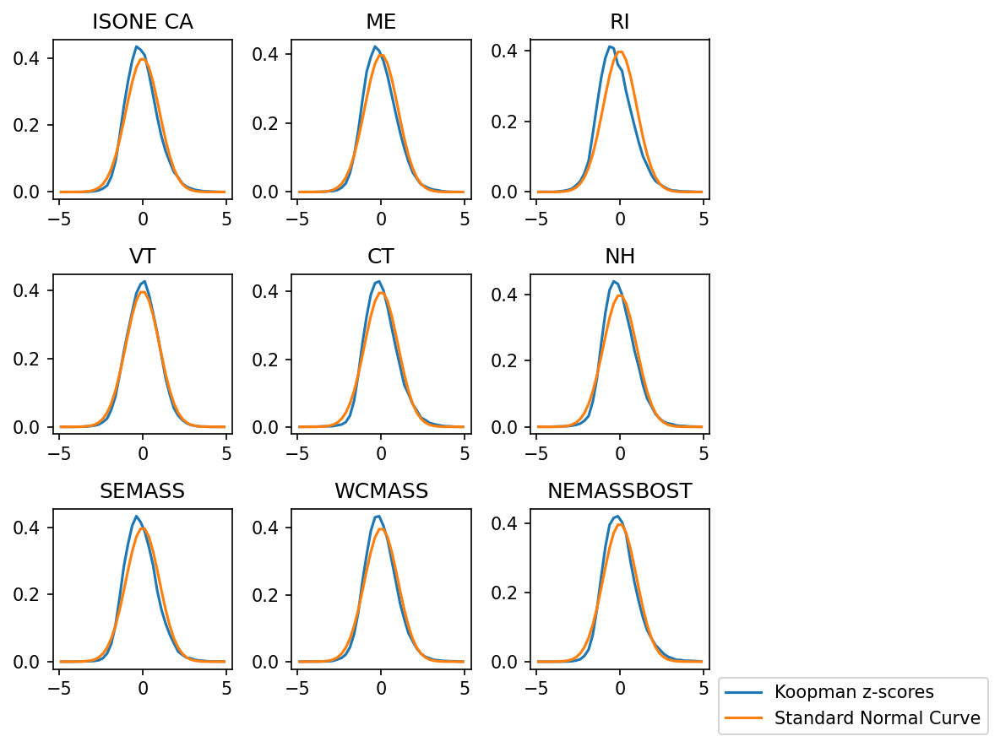

In [22]:
%matplotlib inline
z_hists = []
plt.subplots(dpi=150, figsize=(8, 6))
for i, z_score in enumerate(z_scores):
    month = 2*i
    z_hist, bin_edges = np.histogram(z_score, bins=40, range=(-5, 5), density=True)
    z_hists.append(z_hist)
    z_axis = (bin_edges[1:] + bin_edges[:-1]) / 2
#     print(f"mean of z-scores in month {months[month]}:", np.mean(z_score), "std of z-scores:", np.std(z_score))
    
    plt.subplot(3, 3, i + 1)
    plt.plot(z_axis, z_hist, label="Koopman z-scores")
    plt.plot(z_axis, normal_pdf(0, 1, z_axis), label="Standard Normal Curve")
    plt.title(zones[i])
#     plt.xlabel("z")
plt.legend(loc="upper left", bbox_to_anchor=(1, 0))
plt.tight_layout()
plt.show()

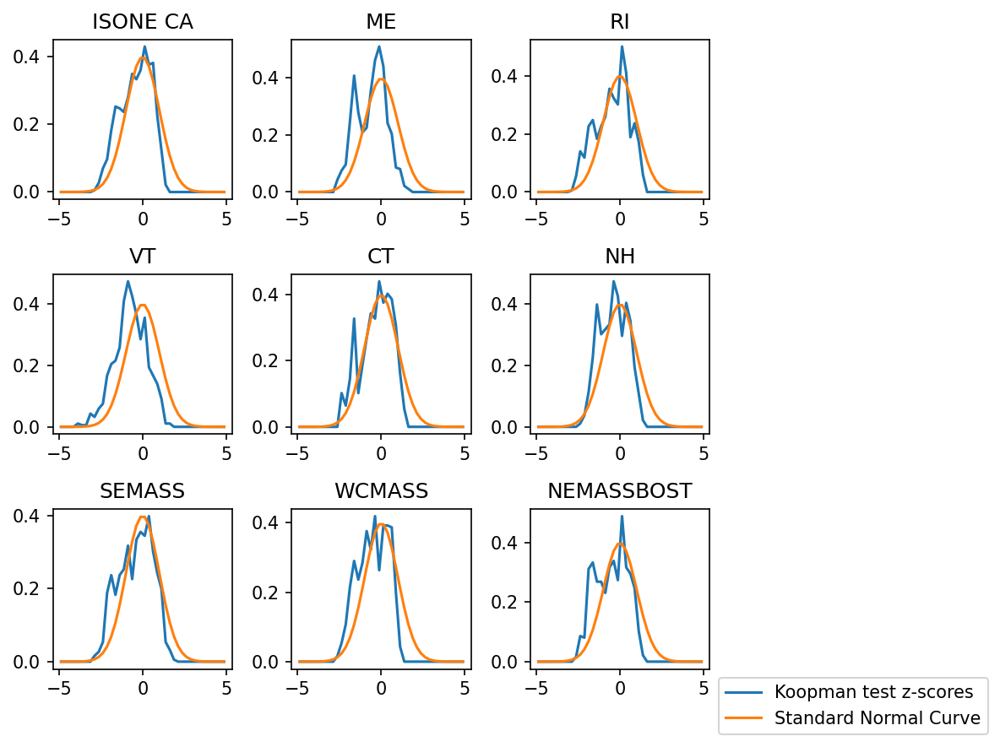

In [23]:
%matplotlib inline
test_z_hists = []
plt.subplots(dpi=150, figsize=(8, 6))
for i, z_score in enumerate(test_z_scores):
    month = 2 * i
    z_hist, bin_edges = np.histogram(z_score, bins=40, range=(-5, 5), density=True)
    test_z_hists.append(z_hist)
    z_axis = (bin_edges[1:] + bin_edges[:-1]) / 2
#     print(f"mean of z-scores in month {month}:", np.mean(z_score), "std of z-scores:", np.std(z_score))
    
    plt.subplot(3, 3, i + 1)
    plt.plot(z_axis, z_hist, label="Koopman test z-scores")
    plt.plot(z_axis, normal_pdf(0, 1, z_axis), label="Standard Normal Curve")
    plt.title(zones[i])
#     plt.xlabel("z")
plt.legend(loc="upper left", bbox_to_anchor=(1, 0))
plt.tight_layout()
plt.show()

(-0.48067210306814695, 0.9287151438805792)

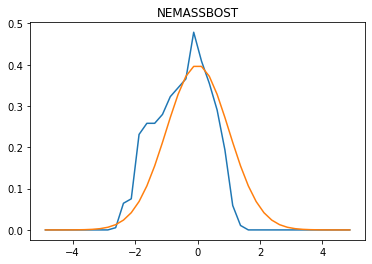

In [24]:
z_score = test_z_scores.mean(axis=0)
z_hist, bin_edges = np.histogram(z_score, bins=40, range=(-5, 5), density=True)
test_z_hists.append(z_hist)
z_axis = (bin_edges[1:] + bin_edges[:-1]) / 2
plt.plot(z_axis, z_hist, label="Koopman test z-scores")
plt.plot(z_axis, normal_pdf(0, 1, z_axis), label="Standard Normal Curve")
plt.title("average over " + month_name)
np.mean(test_z_scores), np.mean(np.std(test_z_scores, axis=1))

In [32]:
std_hat = model.std(params)
mean_hat = model.mean(params)
1/(1 / std_hat).mean()

0.07524628905167986

In [31]:
0.02 / 0.075

0.26666666666666666

<IPython.core.display.Javascript object>


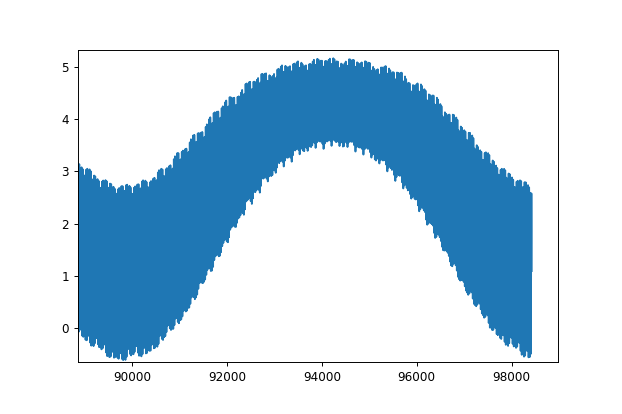

In [21]:
%matplotlib notebook
plt.figure()
plt.plot(a_hat)

In [58]:
T = 1000
weights = 1 + 0.4 * torch.cos(torch.linspace(0, 11 * 2 * np.pi, T) - 2 * np.pi * delay / 8760)
weights *= 1/(1 + torch.exp((3*T / 4 - torch.arange(T)) / (T / 10))) + 0.6
weights[:int(T * 0.4)] = 1

(0.0, 2.5e-05)

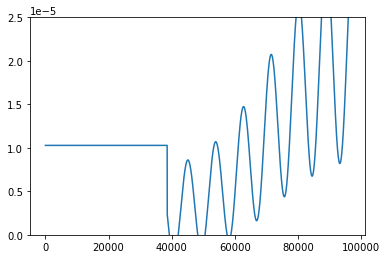

In [31]:
plt.plot(bias_weights)
plt.ylim([0, 2.5e-5])

In [55]:
weights[:].mean()

tensor(1.0042)

ISONE CA
2005-11-10 00:00:00
ISONE CA


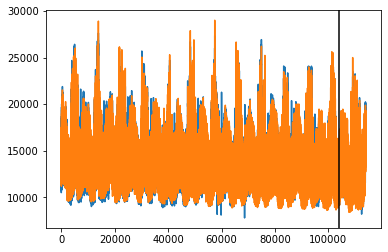

k = 4


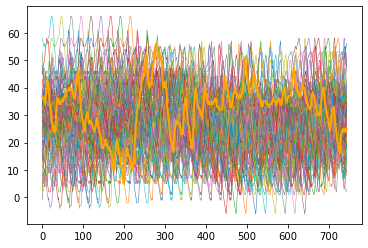

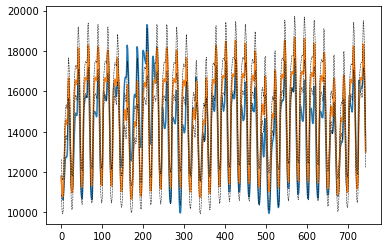

{'ISONE CA': 408.1548293845738}
2005-12-11 00:00:00
ISONE CA


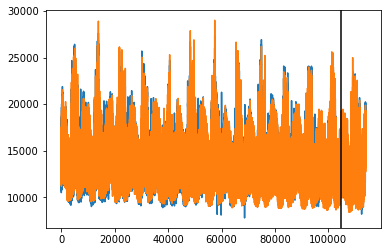

k = 4


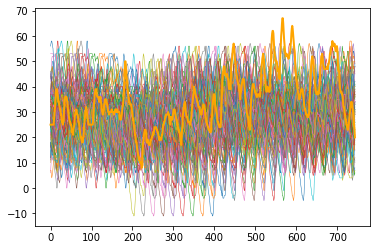

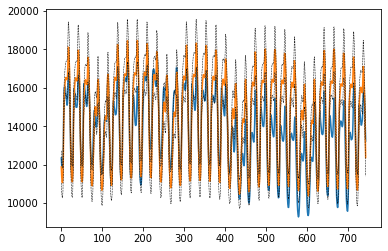

{'ISONE CA': 443.1518695974567}
2006-01-08 00:00:00
ISONE CA


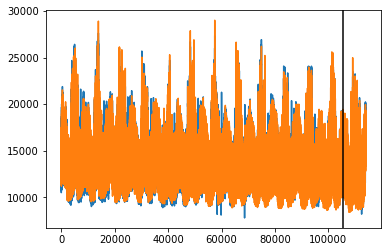

k = 4


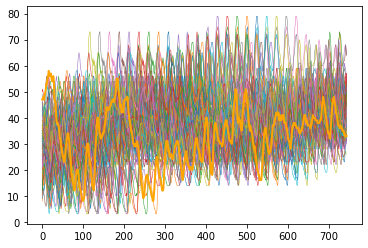

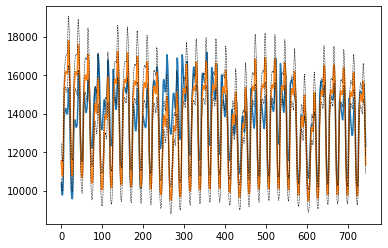

{'ISONE CA': 439.66939319315935}
2006-02-08 00:00:00
ISONE CA


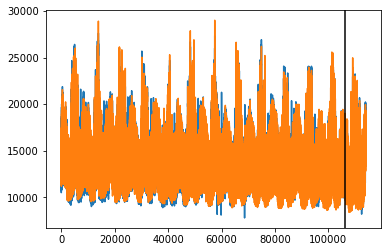

k = 4


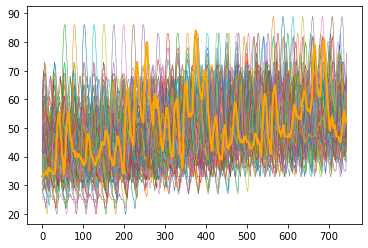

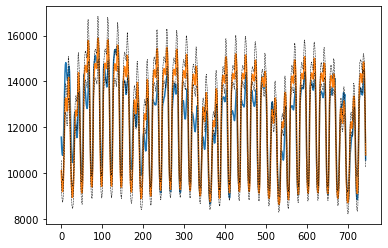

{'ISONE CA': 264.14482297987814}
2006-03-10 00:00:00
ISONE CA


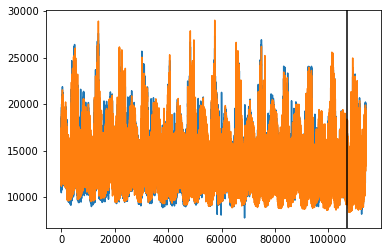

k = 4


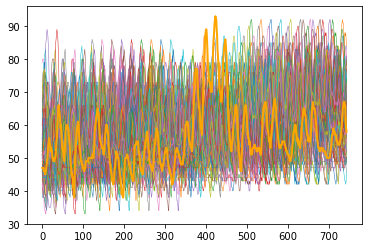

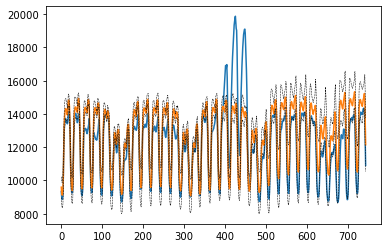

{'ISONE CA': 357.8824069864209}
2006-04-10 00:00:00
ISONE CA


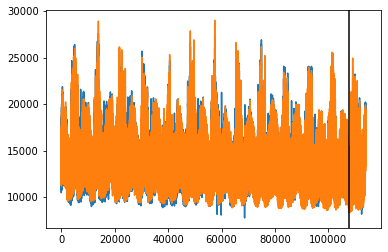

k = 4


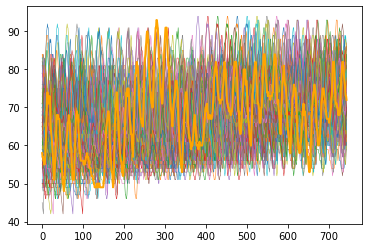

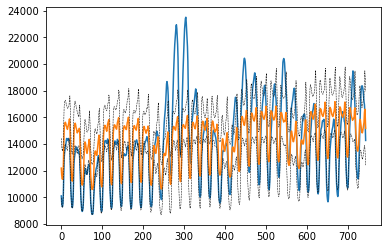

{'ISONE CA': 652.7803806105694}
2006-05-10 00:00:00
ISONE CA


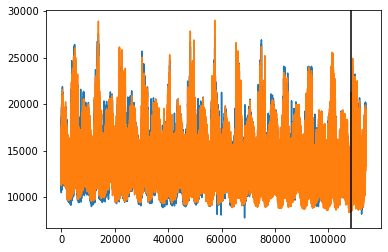

k = 4


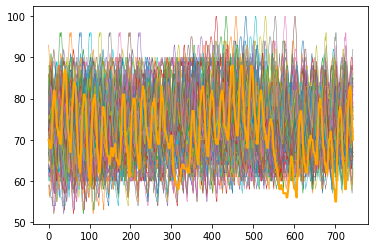

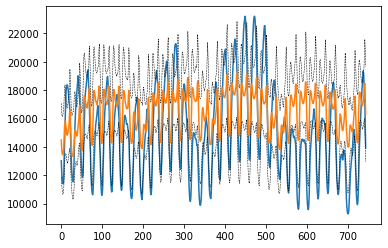

{'ISONE CA': 851.3321358299631}
2006-06-10 00:00:00
ISONE CA


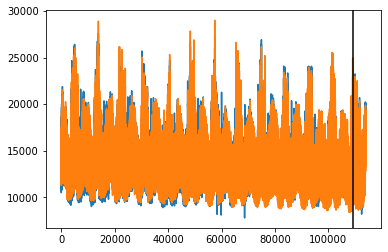

k = 4


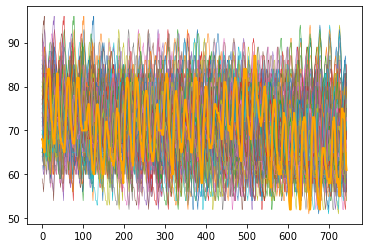

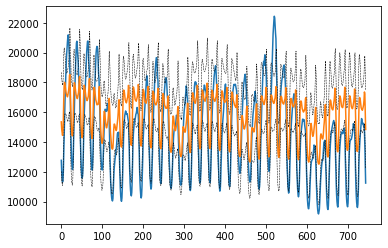

{'ISONE CA': 685.6930050502453}
2006-07-11 00:00:00
ISONE CA


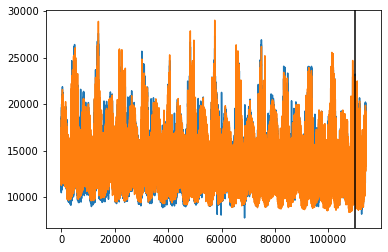

k = 4


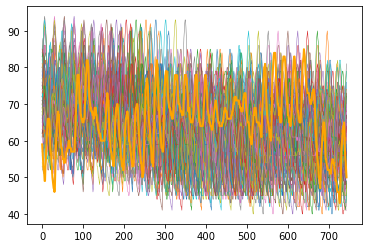

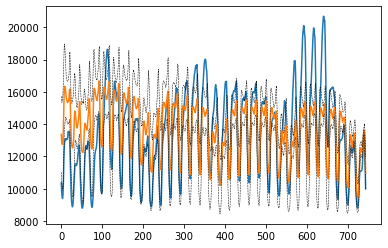

{'ISONE CA': 584.6976079813953}
2006-08-10 00:00:00
ISONE CA


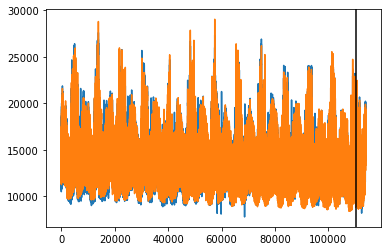

k = 4


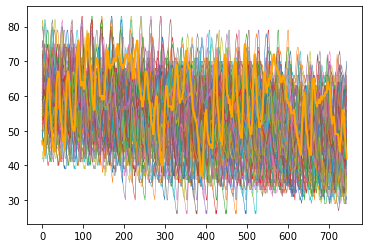

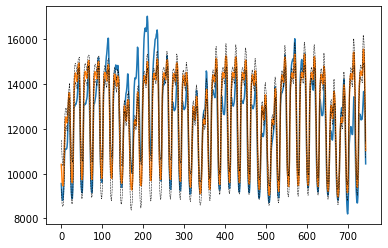

{'ISONE CA': 296.4271424798559}
2006-09-10 00:00:00
ISONE CA


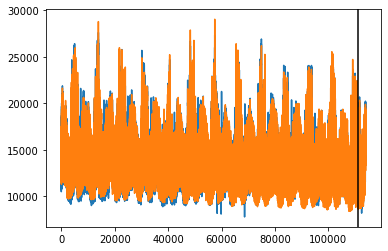

k = 4


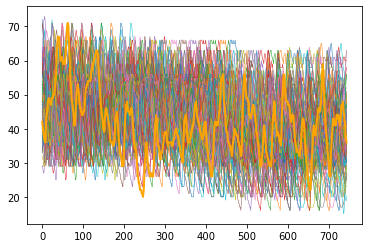

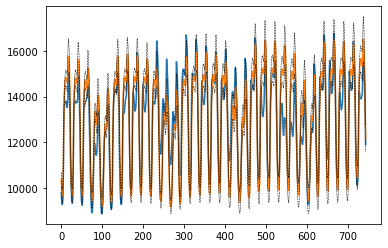

{'ISONE CA': 292.90646286317485}
2006-10-10 00:00:00
ISONE CA


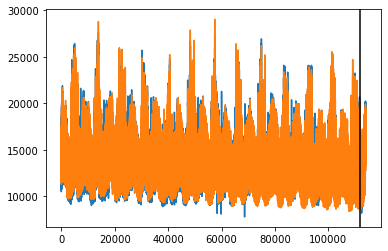

k = 4


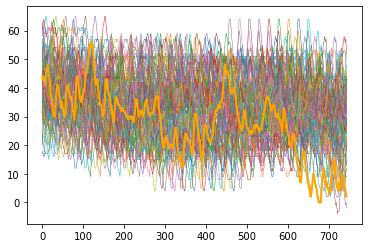

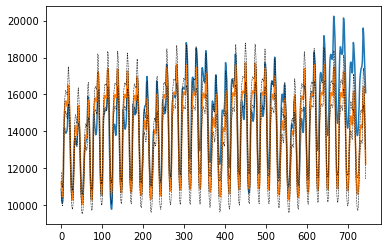

{'ISONE CA': 440.8176836769127}
ME
2005-11-10 00:00:00
ME


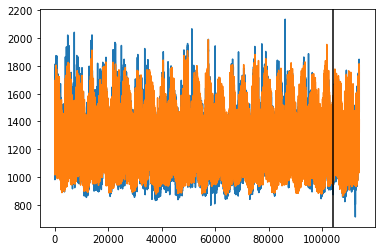

k = 4


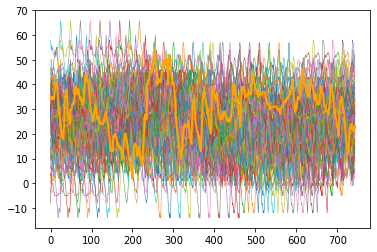

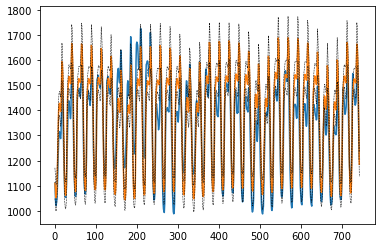

{'ME': 29.233566587803818}
2005-12-11 00:00:00
ME


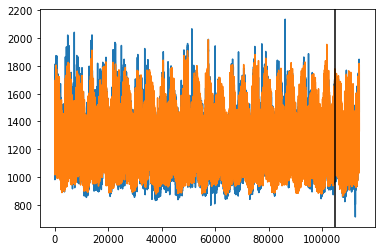

k = 4


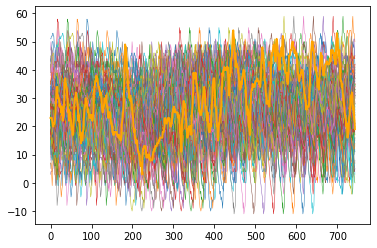

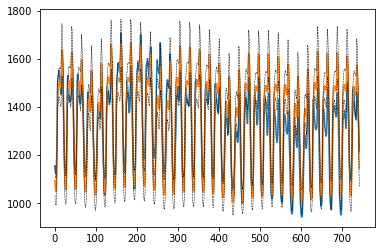

{'ME': 26.692837201950127}
2006-01-08 00:00:00
ME


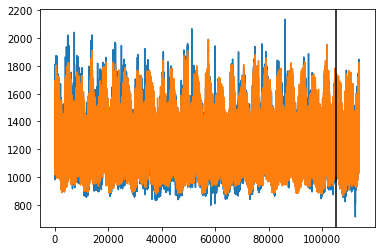

k = 4


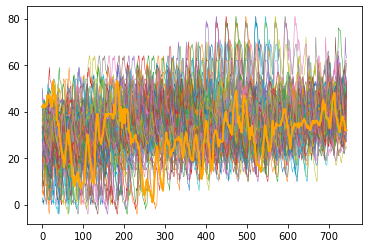

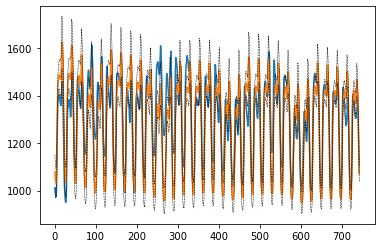

{'ME': 31.045516168685168}
2006-02-08 00:00:00
ME


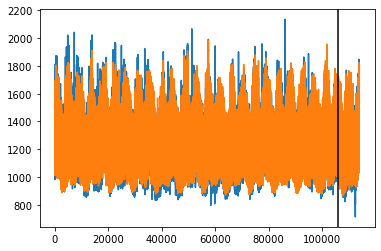

k = 4


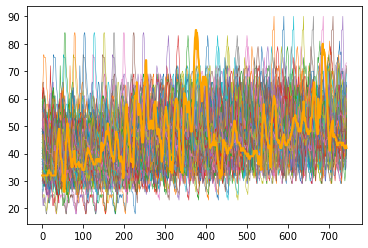

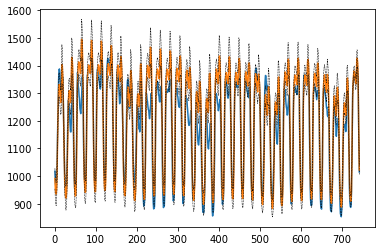

{'ME': 20.790036046341186}
2006-03-10 00:00:00
ME


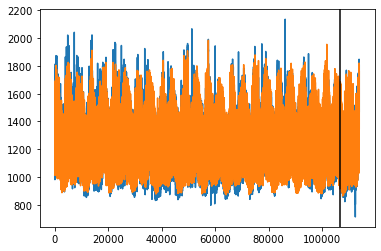

k = 4


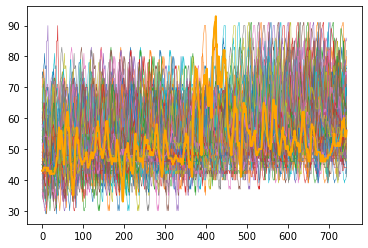

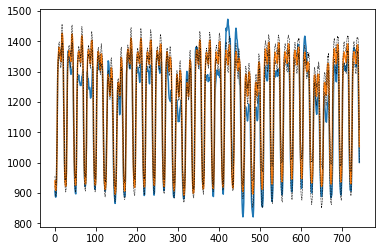

{'ME': 18.163493870926562}
2006-04-10 00:00:00
ME


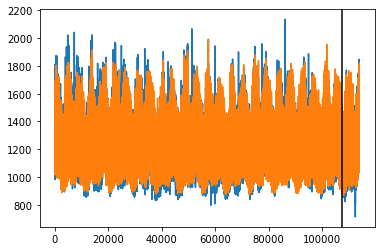

k = 4


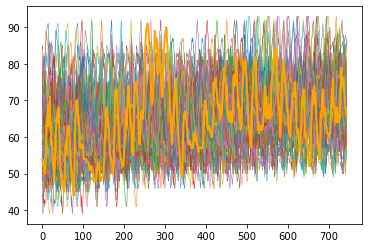

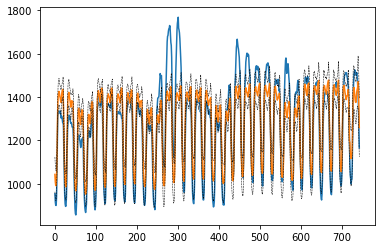

{'ME': 30.590284418401865}
2006-05-10 00:00:00
ME


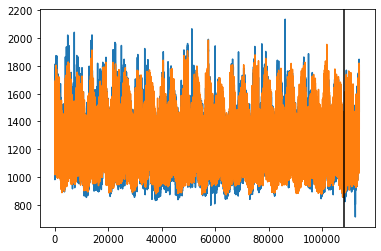

k = 4


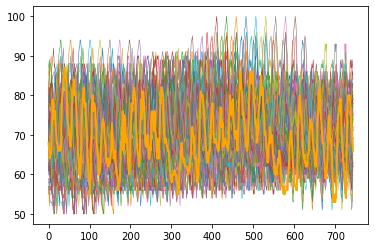

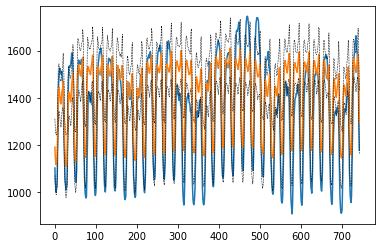

{'ME': 41.3473367044603}
2006-06-10 00:00:00
ME


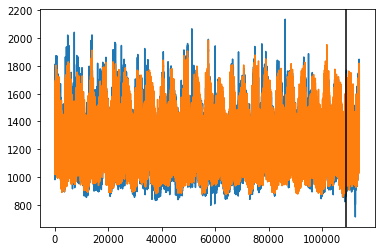

k = 4


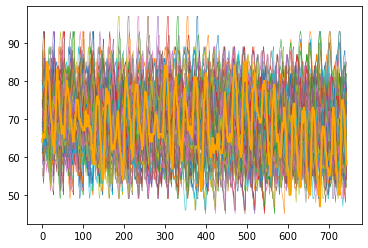

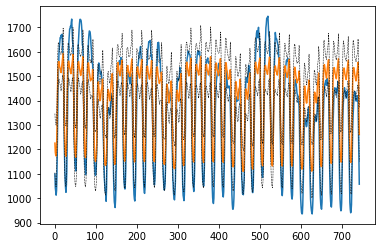

{'ME': 35.175271634429826}
2006-07-11 00:00:00
ME


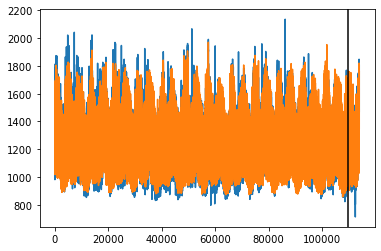

k = 4


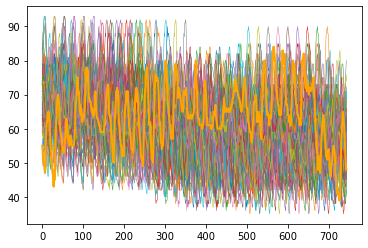

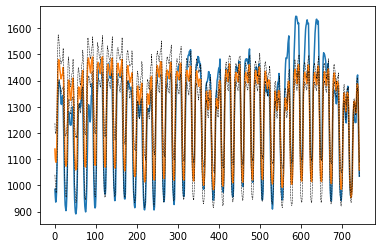

{'ME': 26.598326639268127}
2006-08-10 00:00:00
ME


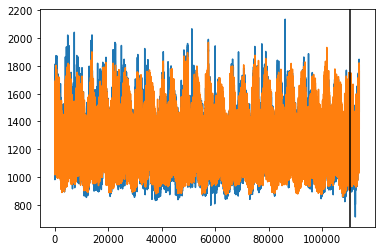

k = 4


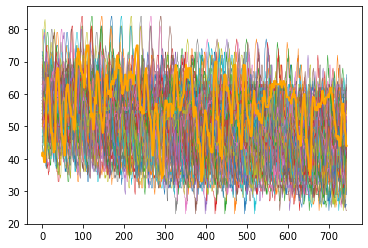

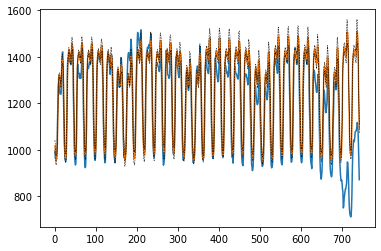

{'ME': 30.981391832060034}
2006-09-10 00:00:00
ME


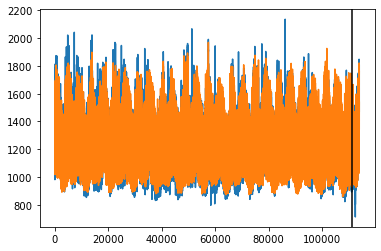

k = 4


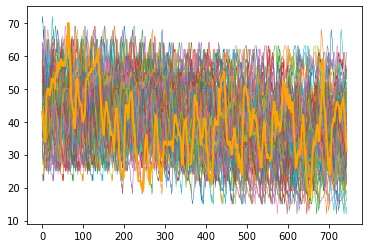

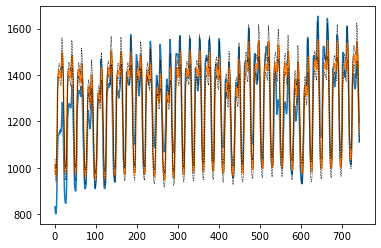

{'ME': 28.27655424271355}
2006-10-10 00:00:00
ME


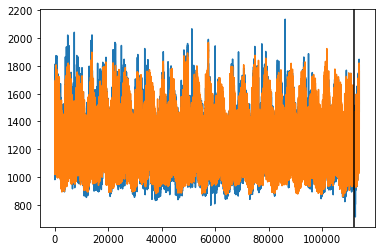

k = 4


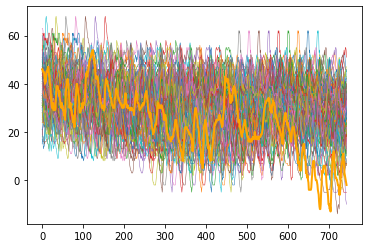

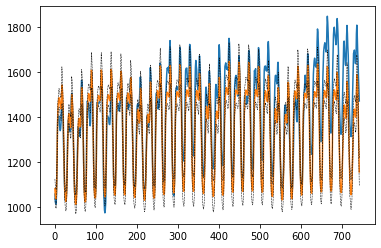

{'ME': 36.7768090390556}
RI
2005-11-10 00:00:00
RI


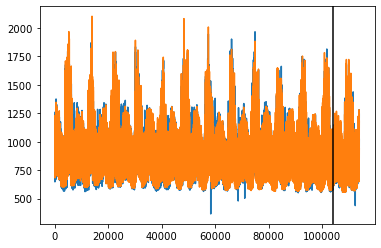

k = 4


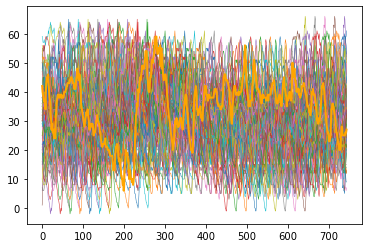

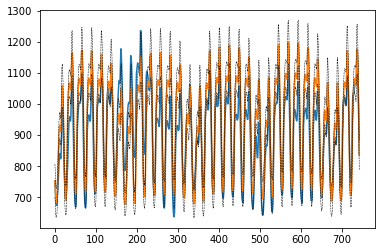

{'RI': 24.87647368189112}
2005-12-11 00:00:00
RI


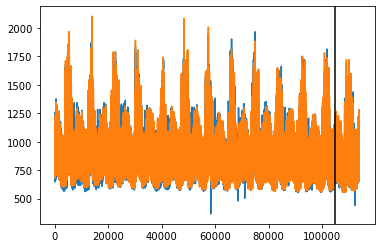

k = 4


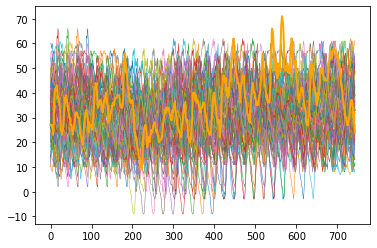

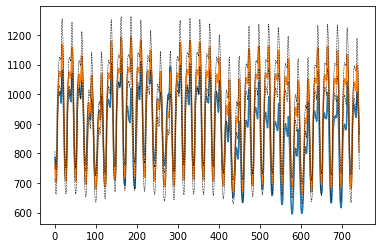

{'RI': 28.17349475772855}
2006-01-08 00:00:00
RI


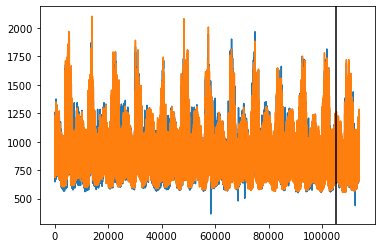

k = 4


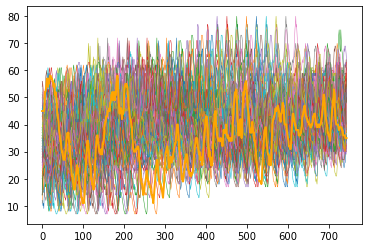

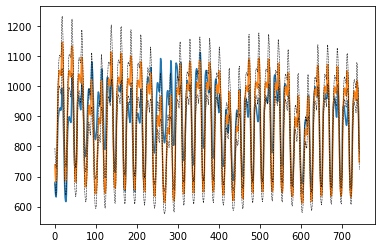

{'RI': 26.425418452213048}
2006-02-08 00:00:00
RI


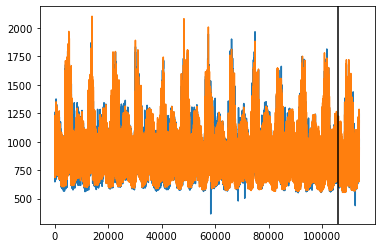

k = 4


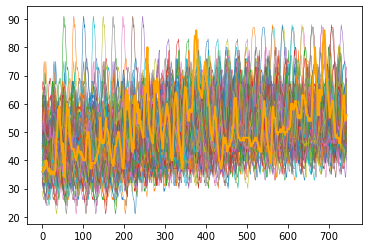

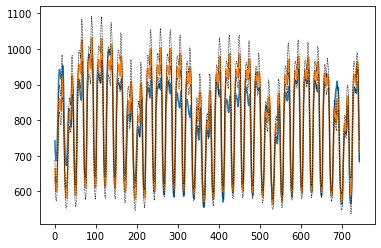

{'RI': 14.92165068608465}
2006-03-10 00:00:00
RI


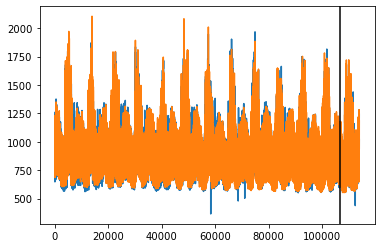

k = 4


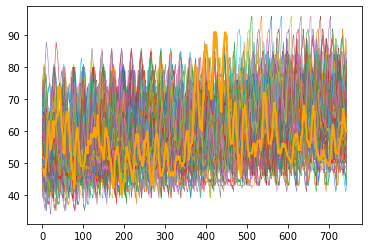

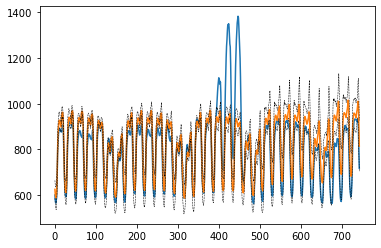

{'RI': 22.61568627317137}
2006-04-10 00:00:00
RI


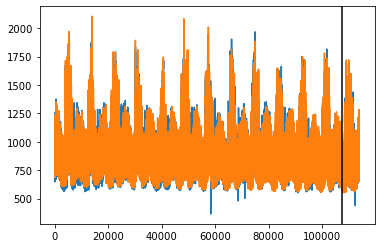

k = 4


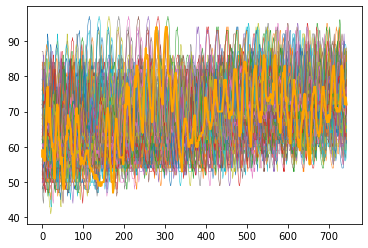

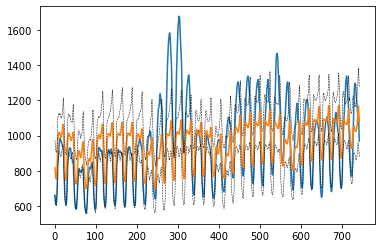

{'RI': 49.263655213514994}
2006-05-10 00:00:00
RI


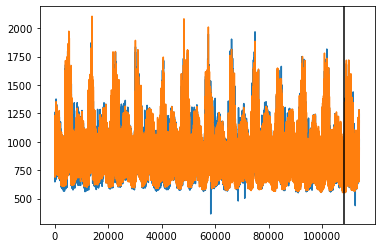

k = 4


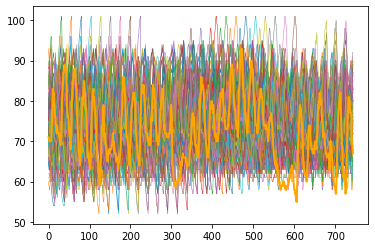

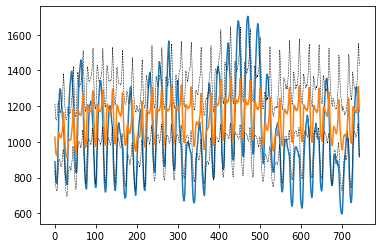

{'RI': 68.07470007050351}
2006-06-10 00:00:00
RI


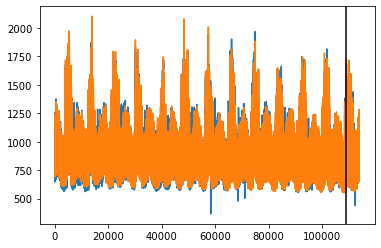

k = 4


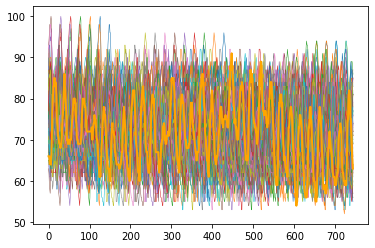

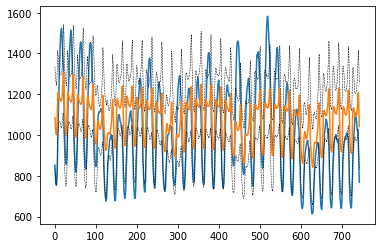

{'RI': 54.367698802281254}
2006-07-11 00:00:00
RI


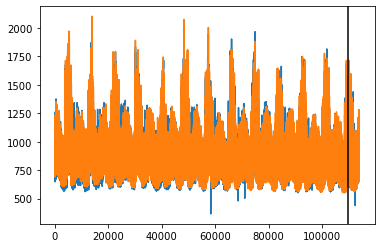

k = 4


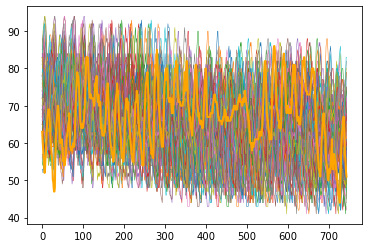

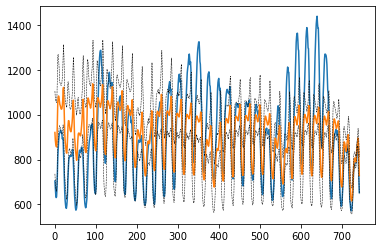

{'RI': 44.70689040350833}
2006-08-10 00:00:00
RI


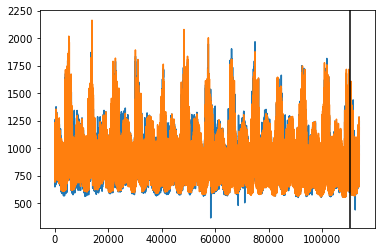

k = 4


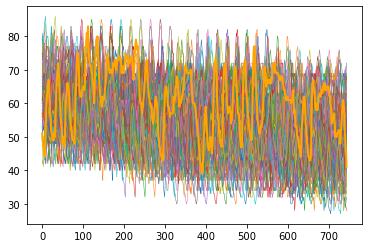

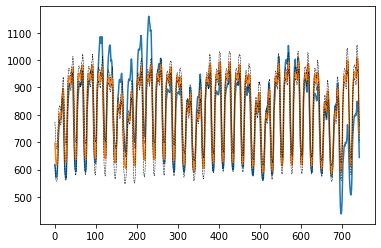

{'RI': 21.07133479470931}
2006-09-10 00:00:00
RI


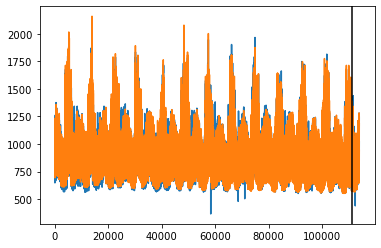

k = 4


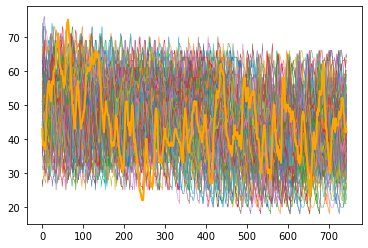

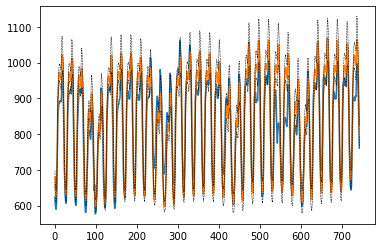

{'RI': 16.10131745929902}
2006-10-10 00:00:00
RI


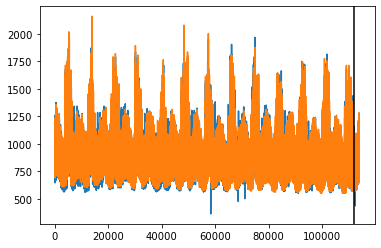

k = 4


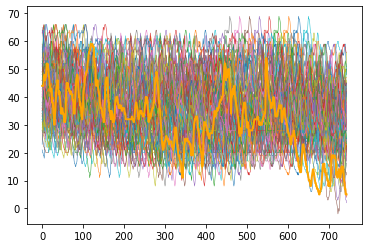

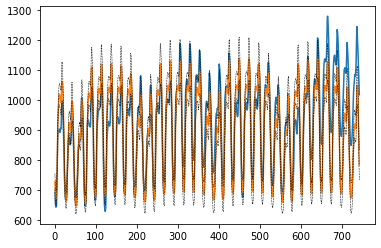

{'RI': 24.340919746820667}
VT
2005-11-10 00:00:00
VT


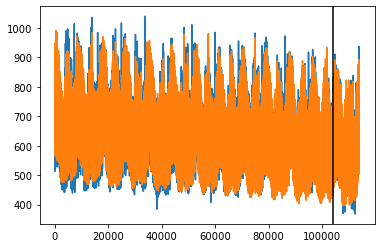

k = 4


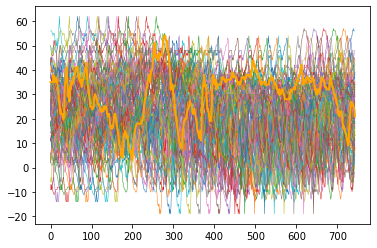

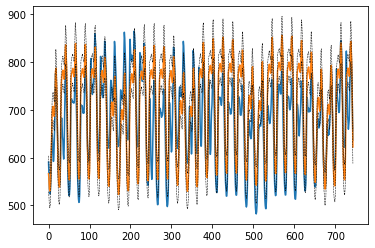

{'VT': 23.063410324102776}
2005-12-11 00:00:00
VT


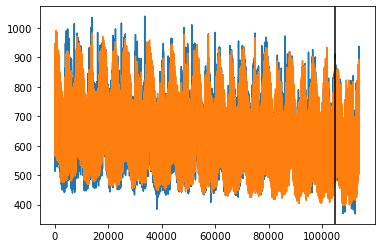

k = 4


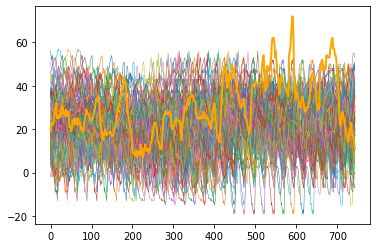

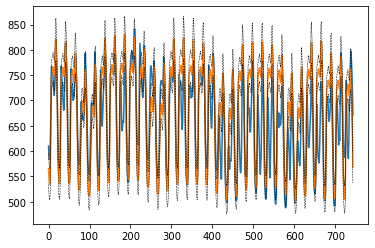

{'VT': 17.33091738968048}
2006-01-08 00:00:00
VT


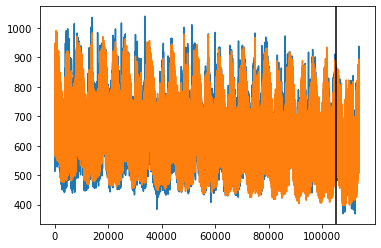

k = 4


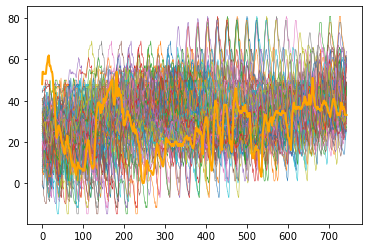

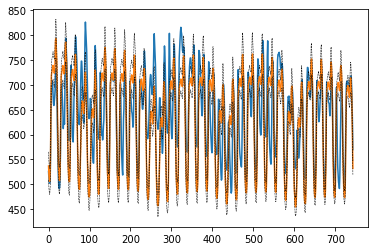

{'VT': 24.951993825685896}
2006-02-08 00:00:00
VT


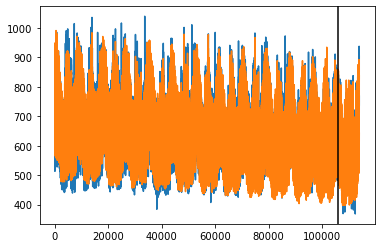

k = 4


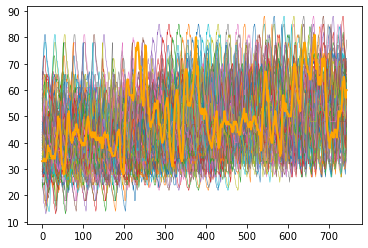

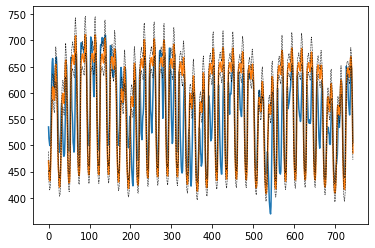

{'VT': 21.211305470103238}
2006-03-10 00:00:00
VT


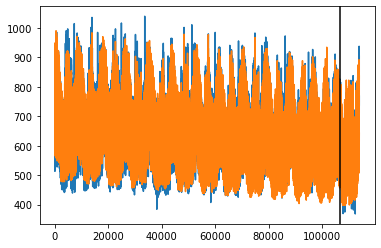

k = 4


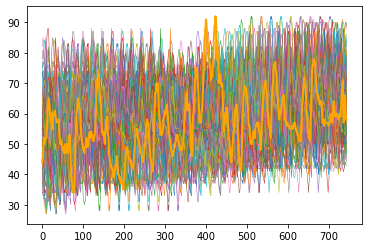

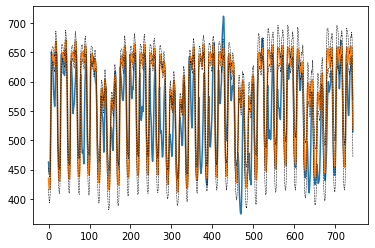

{'VT': 19.116892372899315}
2006-04-10 00:00:00
VT


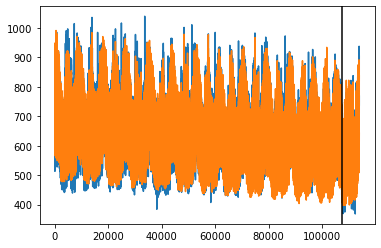

k = 4


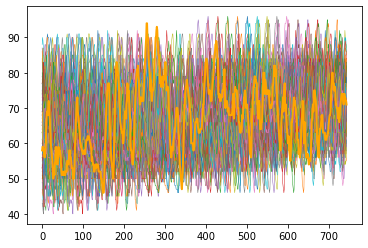

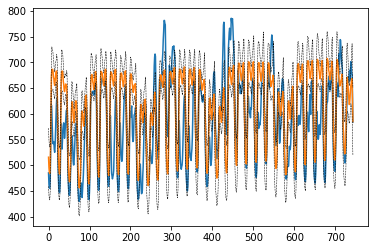

{'VT': 20.730293417607}
2006-05-10 00:00:00
VT


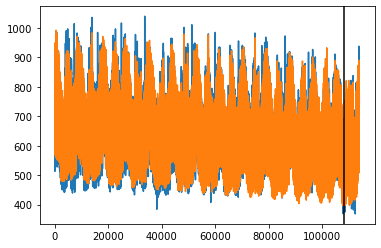

k = 4


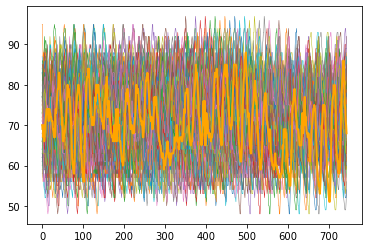

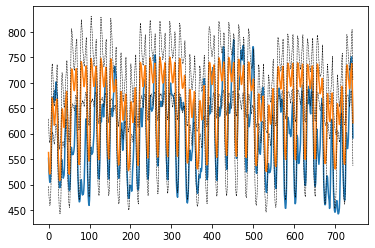

{'VT': 23.976316094198975}
2006-06-10 00:00:00
VT


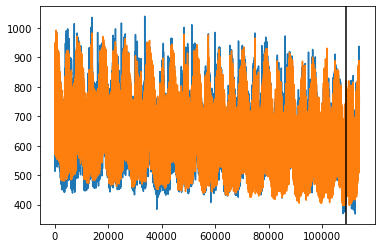

k = 4


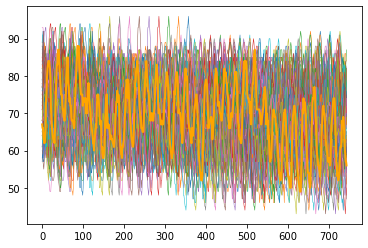

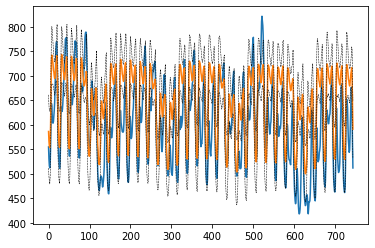

{'VT': 23.619663117394254}
2006-07-11 00:00:00
VT


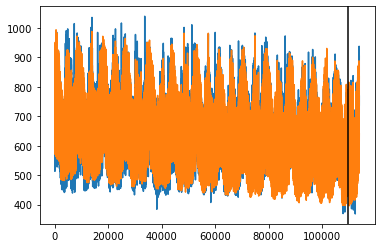

k = 4


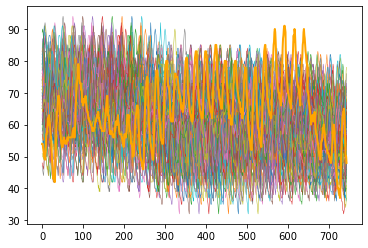

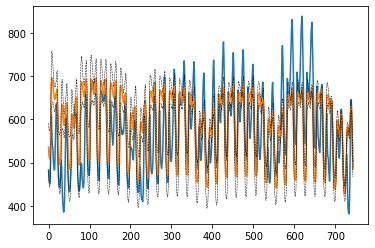

{'VT': 23.609767956495705}
2006-08-10 00:00:00
VT


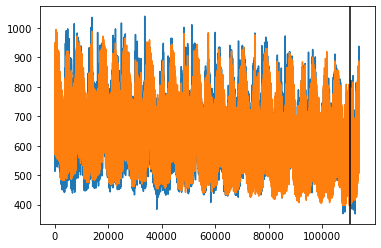

k = 4


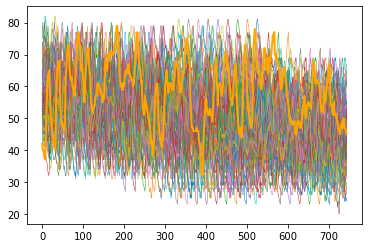

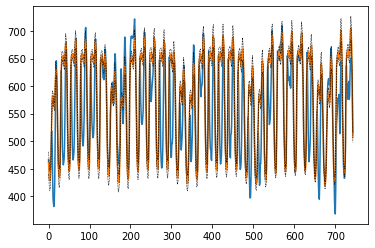

{'VT': 20.106963729026692}
2006-09-10 00:00:00
VT


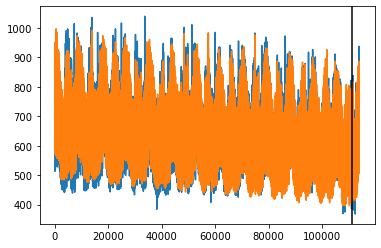

k = 4


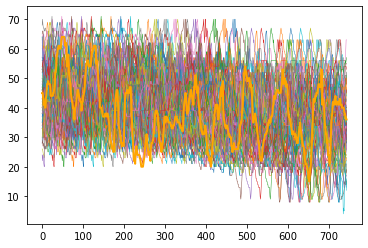

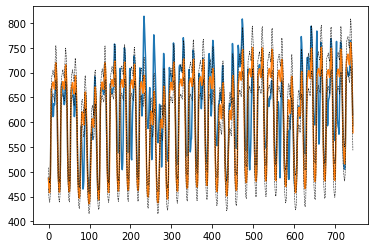

{'VT': 17.959219892885216}
2006-10-10 00:00:00
VT


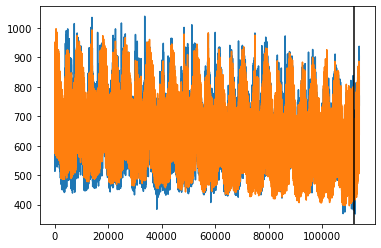

k = 4


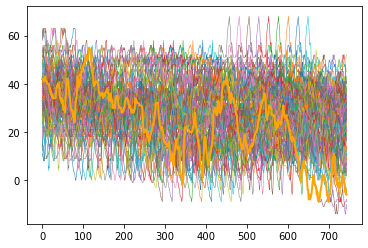

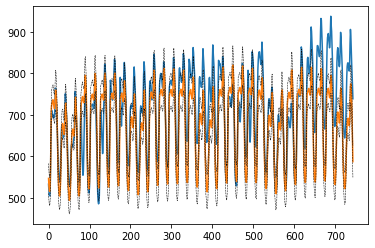

{'VT': 22.056467697110925}
CT
2005-11-10 00:00:00
CT


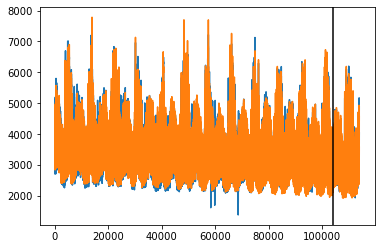

k = 4


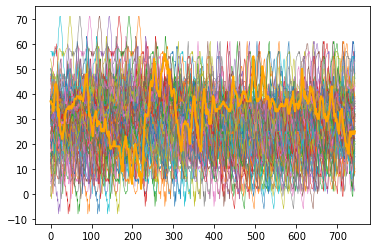

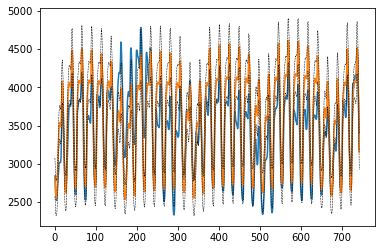

{'CT': 112.56125637419582}
2005-12-11 00:00:00
CT


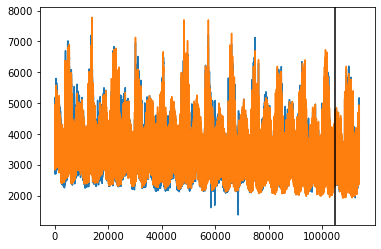

k = 4


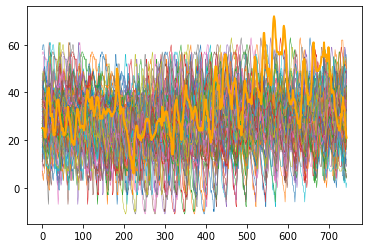

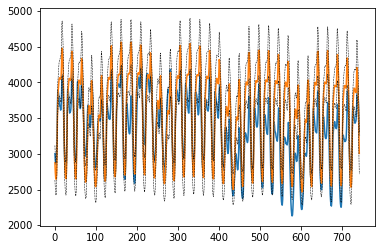

{'CT': 124.61921717271497}
2006-01-08 00:00:00
CT


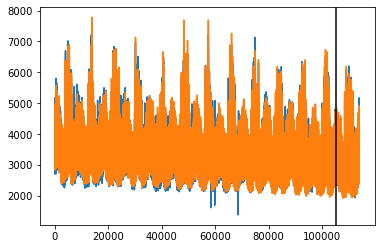

k = 4


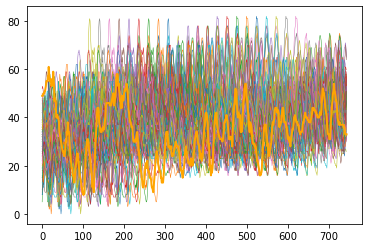

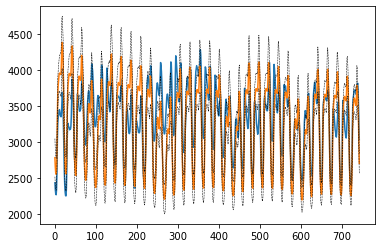

{'CT': 124.77616777720593}
2006-02-08 00:00:00
CT


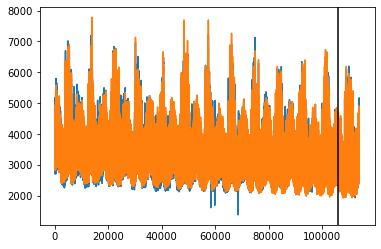

k = 4


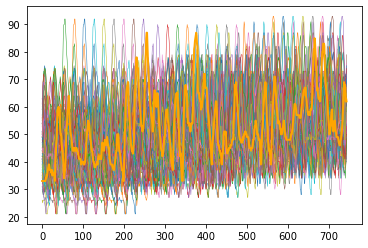

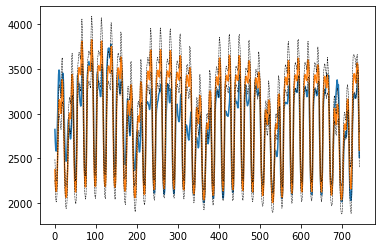

{'CT': 69.09779336163629}
2006-03-10 00:00:00
CT


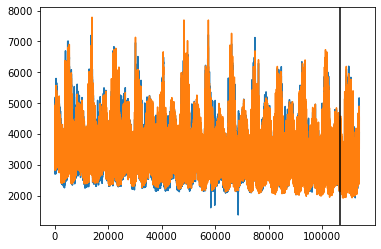

k = 4


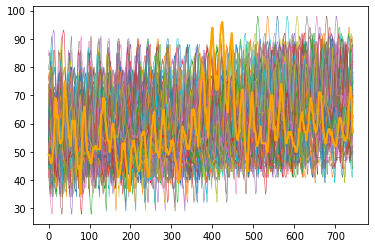

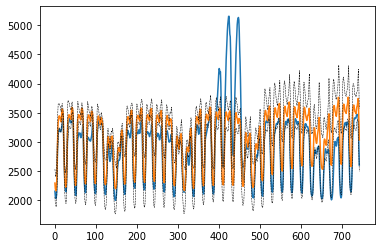

{'CT': 100.97003427526913}
2006-04-10 00:00:00
CT


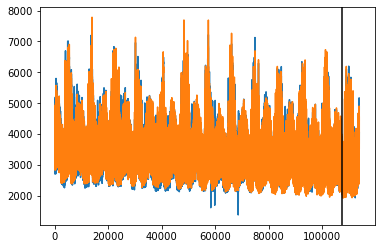

k = 4


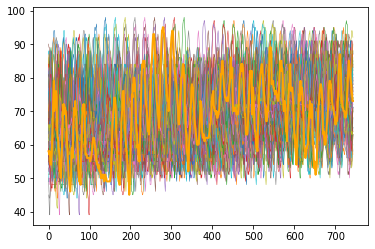

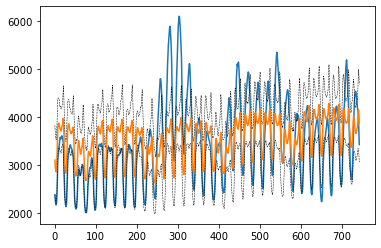

{'CT': 197.4759264704288}
2006-05-10 00:00:00
CT


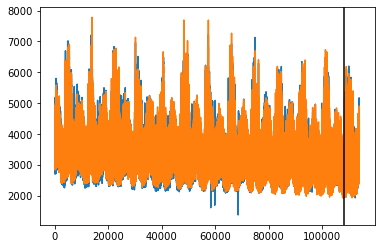

k = 4


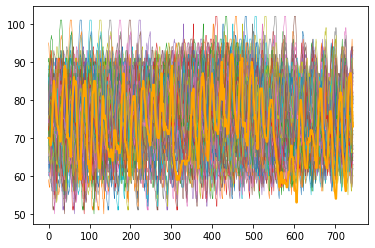

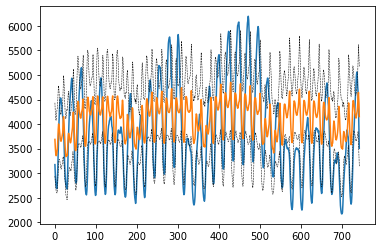

{'CT': 257.6720267574364}
2006-06-10 00:00:00
CT


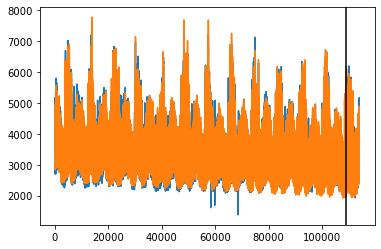

k = 4


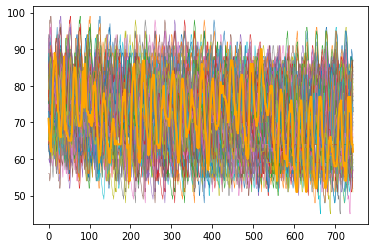

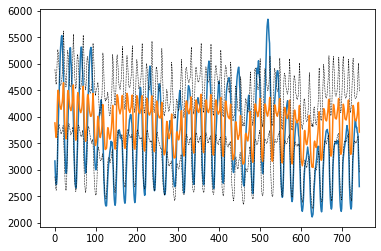

{'CT': 204.78341184399824}
2006-07-11 00:00:00
CT


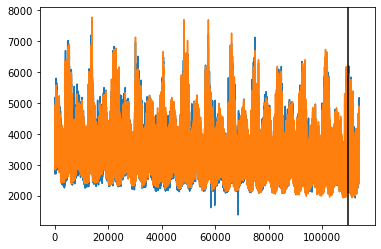

k = 4


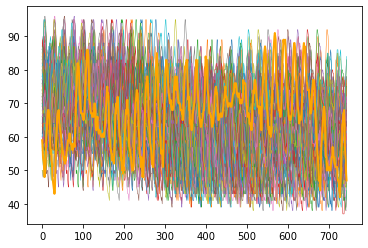

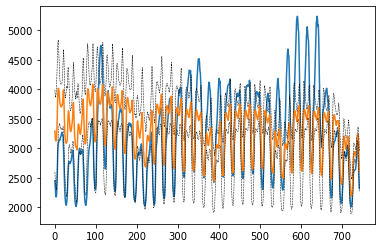

{'CT': 174.8208468062396}
2006-08-10 00:00:00
CT


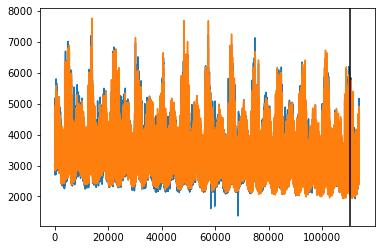

k = 4


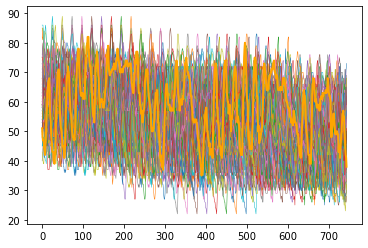

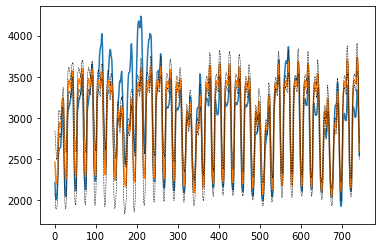

{'CT': 77.18991842699968}
2006-09-10 00:00:00
CT


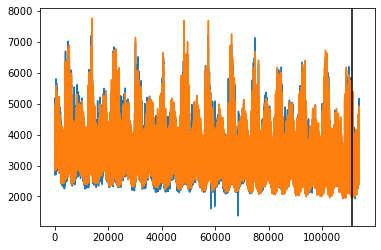

k = 4


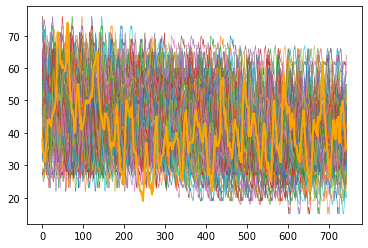

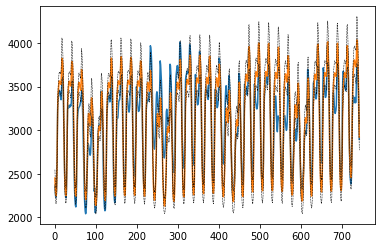

{'CT': 75.97358418254808}
2006-10-10 00:00:00
CT


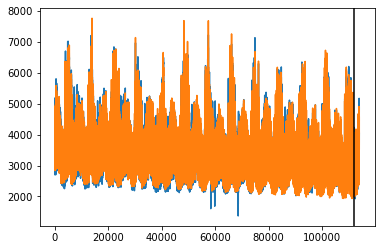

k = 4


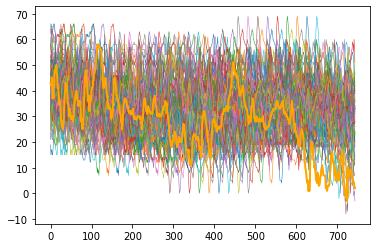

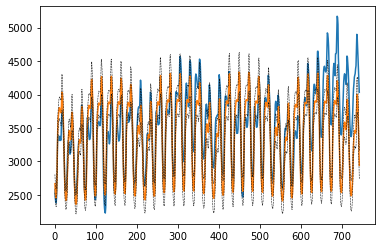

{'CT': 120.71927385279025}
NH
2005-11-10 00:00:00
NH


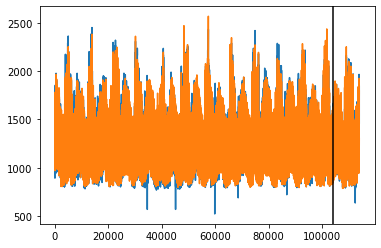

k = 4


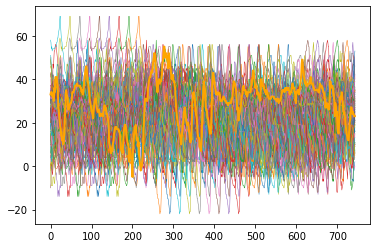

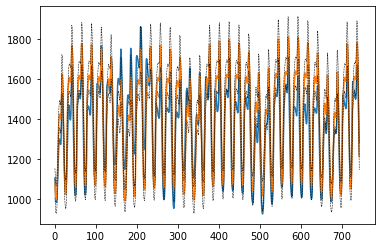

{'NH': 35.73632207370325}
2005-12-11 00:00:00
NH


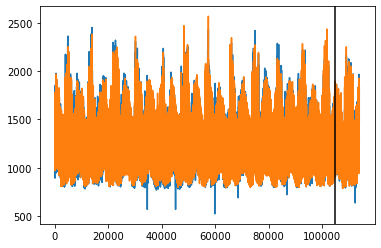

k = 4


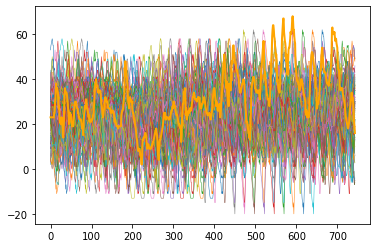

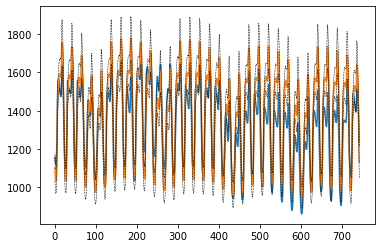

{'NH': 35.60636553545988}
2006-01-08 00:00:00
NH


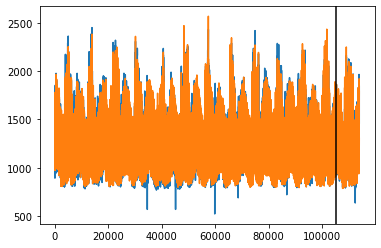

k = 4


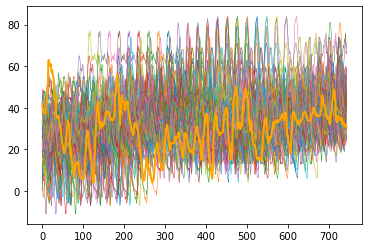

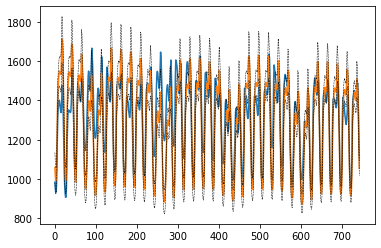

{'NH': 39.115508304404315}
2006-02-08 00:00:00
NH


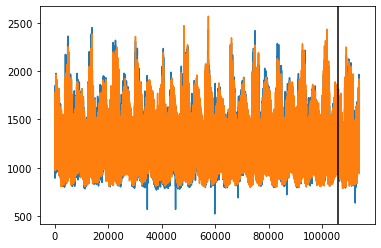

k = 4


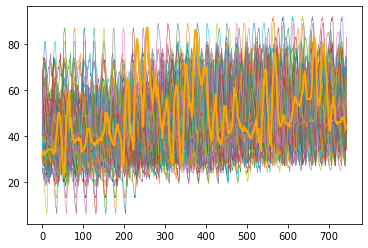

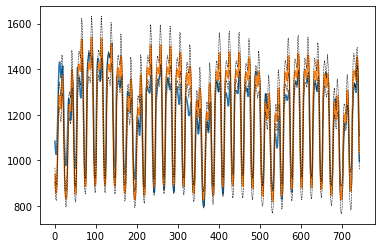

{'NH': 21.693562362465123}
2006-03-10 00:00:00
NH


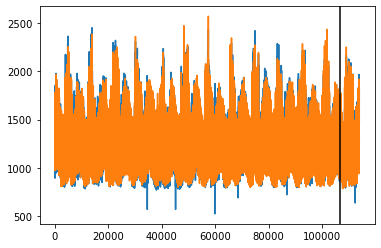

k = 4


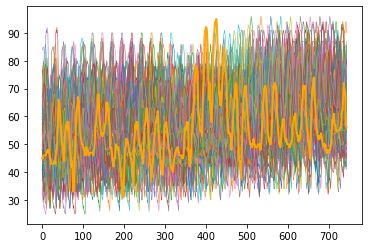

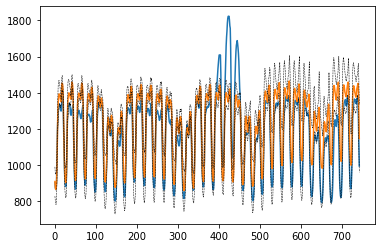

{'NH': 29.510675442595605}
2006-04-10 00:00:00
NH


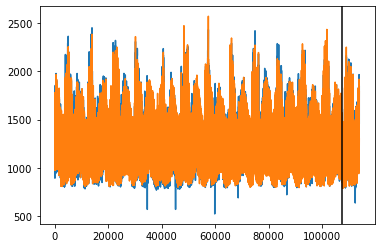

k = 4


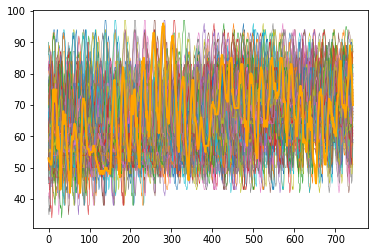

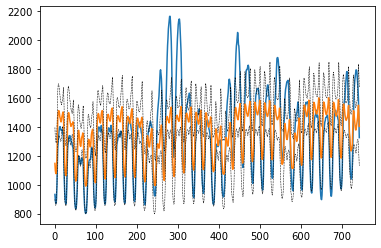

{'NH': 61.31076510546661}
2006-05-10 00:00:00
NH


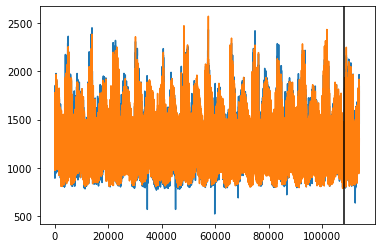

k = 4


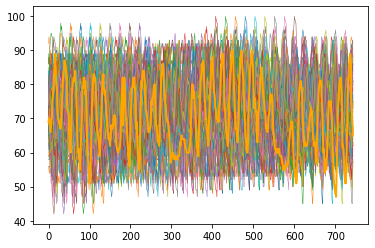

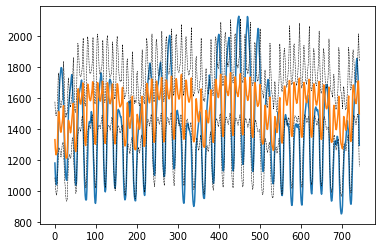

{'NH': 75.39838922792899}
2006-06-10 00:00:00
NH


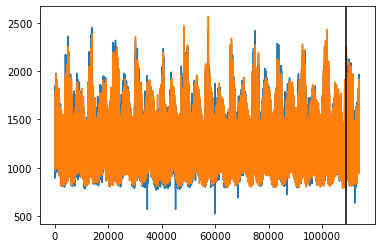

k = 4


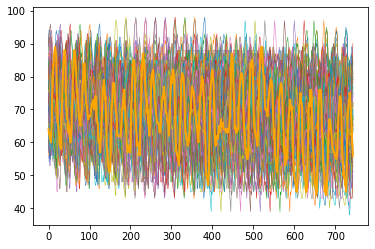

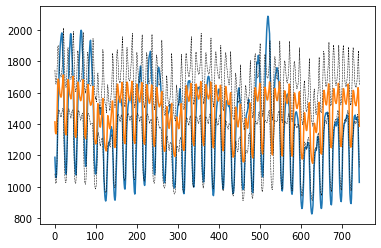

{'NH': 62.84427995353851}
2006-07-11 00:00:00
NH


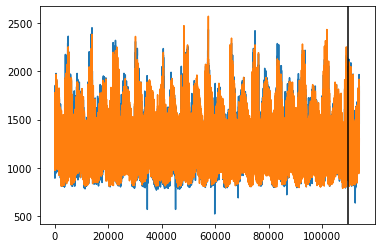

k = 4


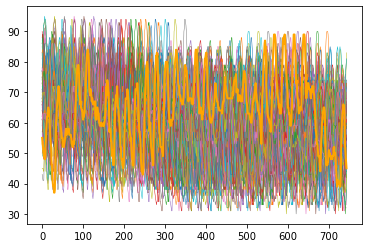

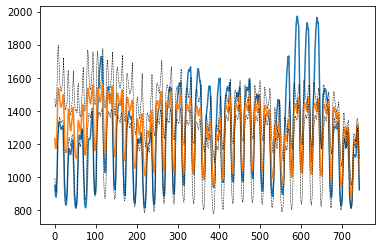

{'NH': 50.9533411704563}
2006-08-10 00:00:00
NH


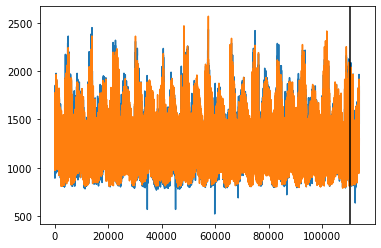

k = 4


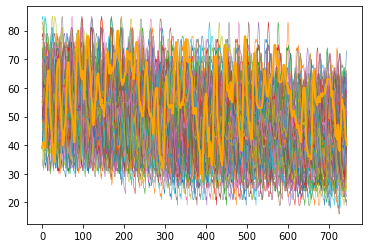

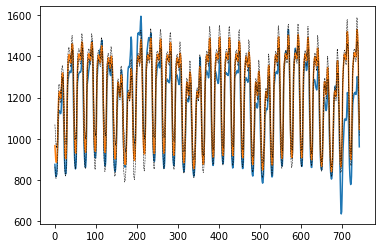

{'NH': 27.98798507432087}
2006-09-10 00:00:00
NH


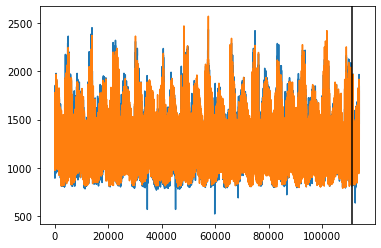

k = 4


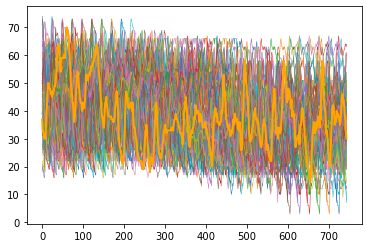

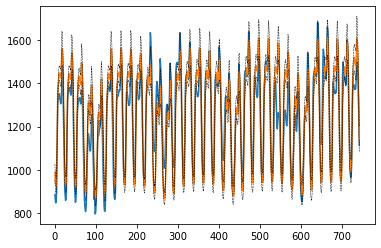

{'NH': 28.872131208507543}
2006-10-10 00:00:00
NH


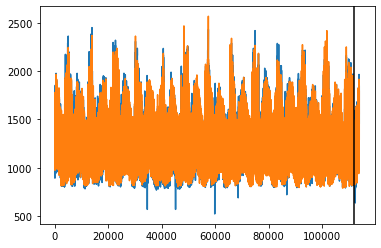

k = 4


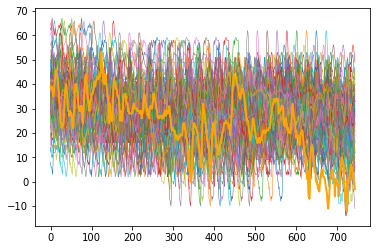

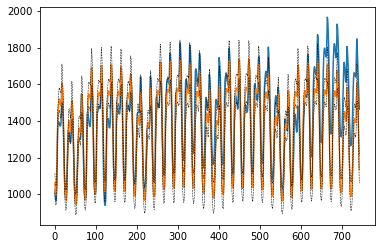

{'NH': 39.95264976176488}
SEMASS
2005-11-10 00:00:00
SEMASS


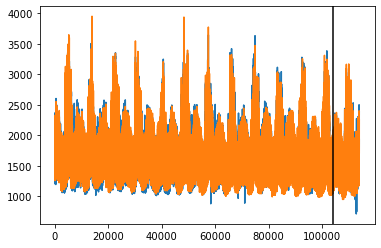

k = 4


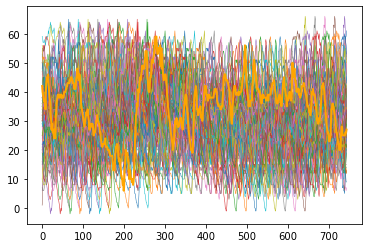

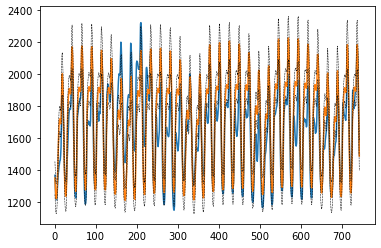

{'SEMASS': 51.19988396718762}
2005-12-11 00:00:00
SEMASS


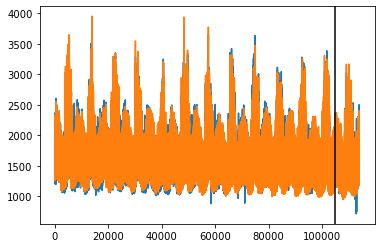

k = 4


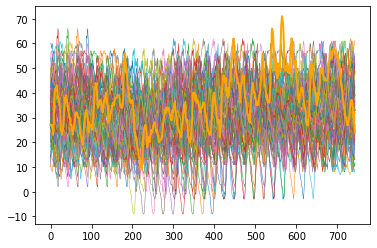

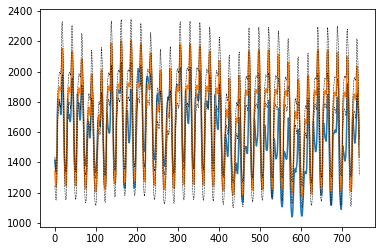

{'SEMASS': 61.938971064743455}
2006-01-08 00:00:00
SEMASS


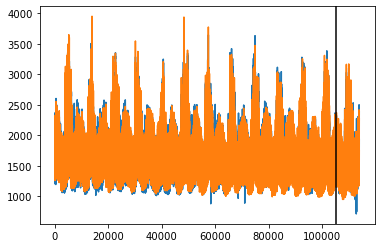

k = 4


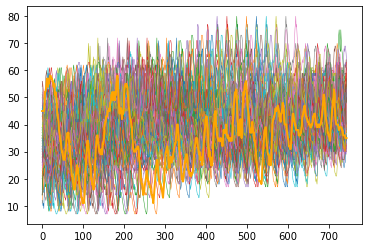

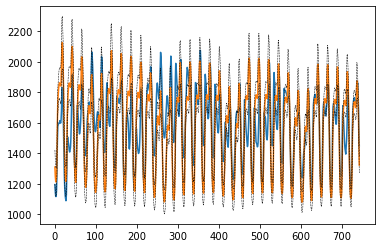

{'SEMASS': 59.61497217637742}
2006-02-08 00:00:00
SEMASS


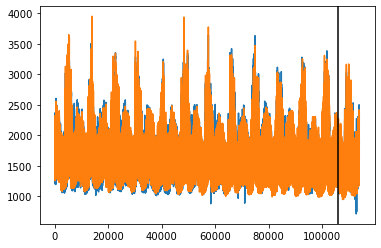

k = 4


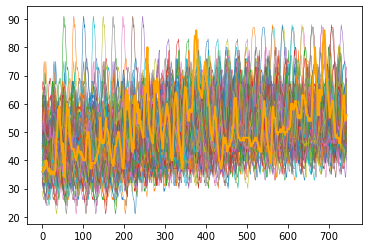

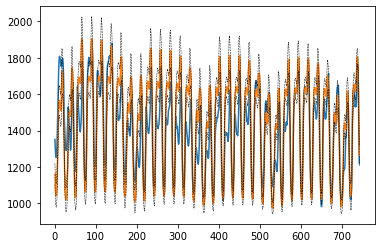

{'SEMASS': 43.57530230440189}
2006-03-10 00:00:00
SEMASS


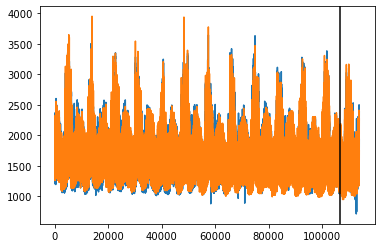

k = 4


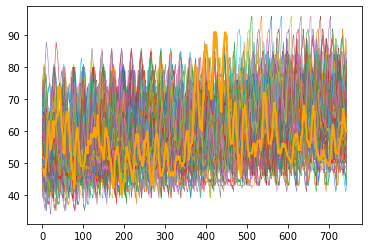

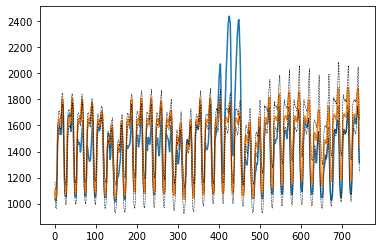

{'SEMASS': 47.698605064031646}
2006-04-10 00:00:00
SEMASS


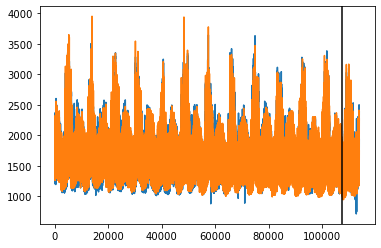

k = 4


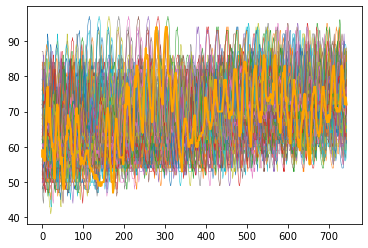

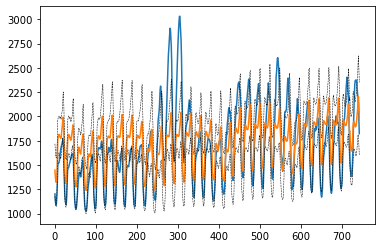

{'SEMASS': 83.76751984108517}
2006-05-10 00:00:00
SEMASS


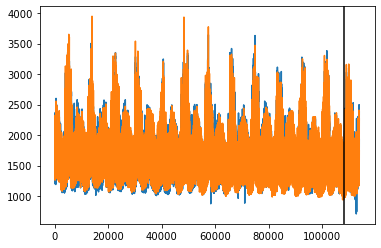

k = 4


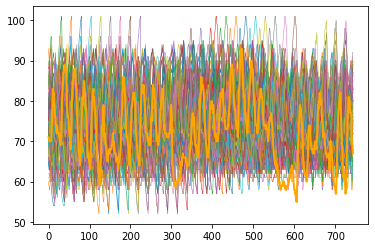

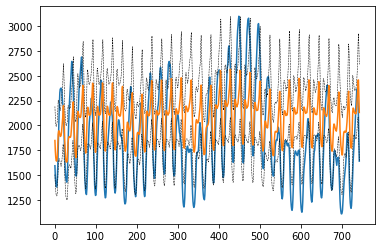

{'SEMASS': 123.01167727199517}
2006-06-10 00:00:00
SEMASS


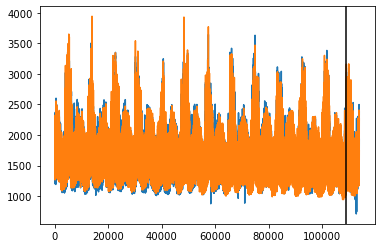

k = 4


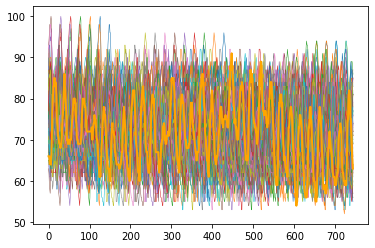

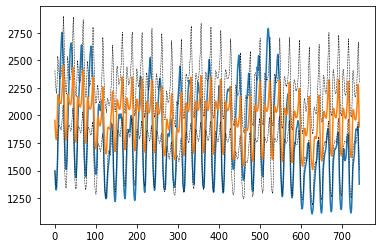

{'SEMASS': 99.54187189306816}
2006-07-11 00:00:00
SEMASS


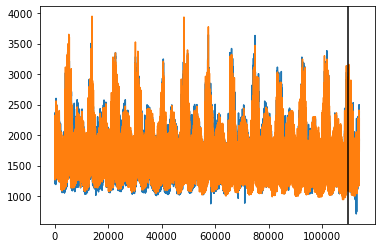

k = 4


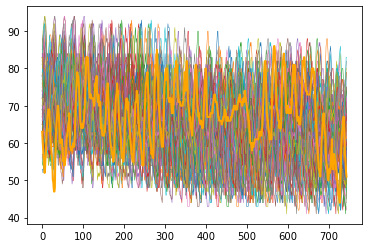

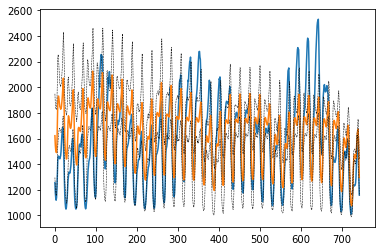

{'SEMASS': 71.60202471748643}
2006-08-10 00:00:00
SEMASS


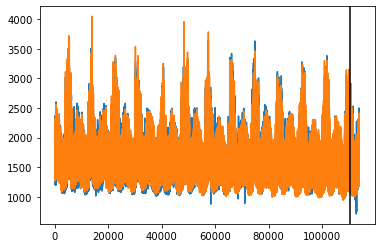

k = 4


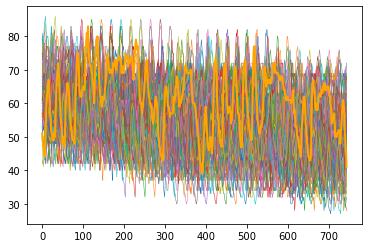

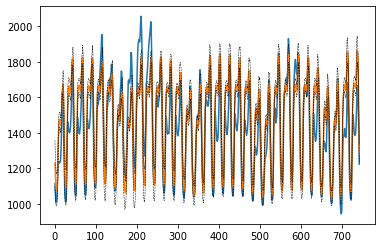

{'SEMASS': 42.73726010868462}
2006-09-10 00:00:00
SEMASS


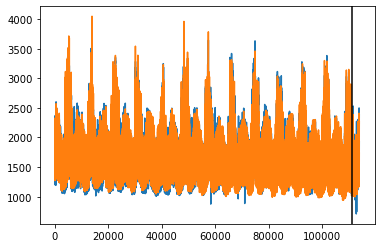

k = 4


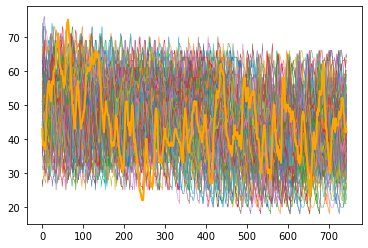

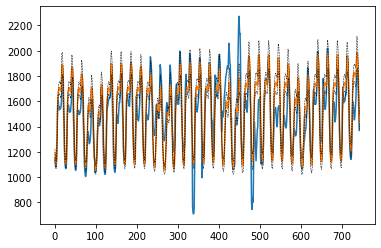

{'SEMASS': 51.09684583105173}
2006-10-10 00:00:00
SEMASS


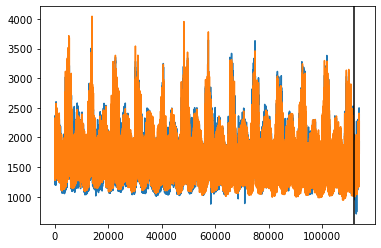

k = 4


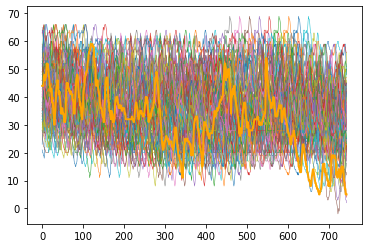

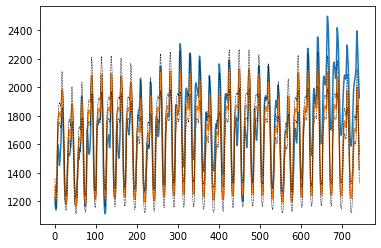

{'SEMASS': 56.94441348209503}
WCMASS
2005-11-10 00:00:00
WCMASS


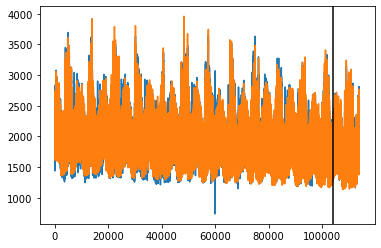

k = 4


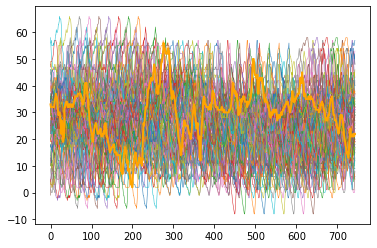

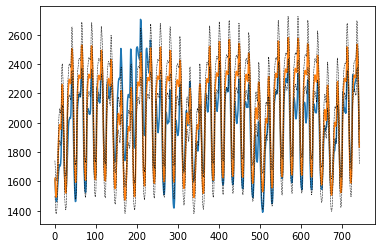

{'WCMASS': 54.263446244521774}
2005-12-11 00:00:00
WCMASS


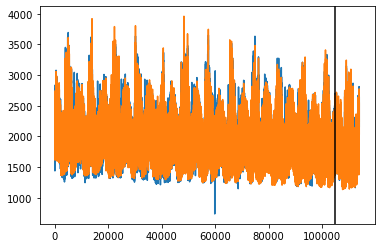

k = 4


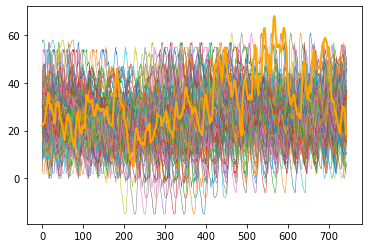

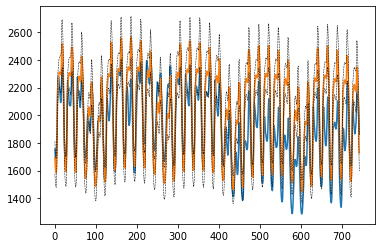

{'WCMASS': 68.6095973227989}
2006-01-08 00:00:00
WCMASS


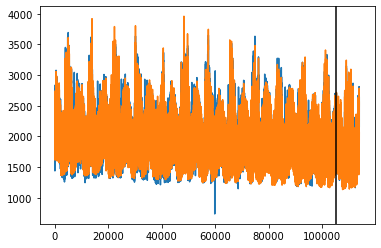

k = 4


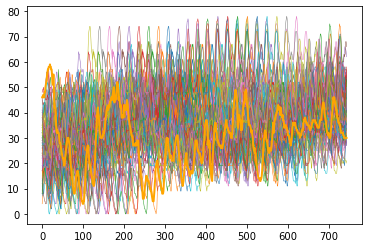

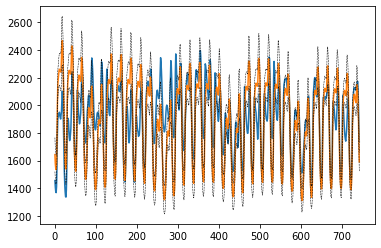

{'WCMASS': 64.66549006457169}
2006-02-08 00:00:00
WCMASS


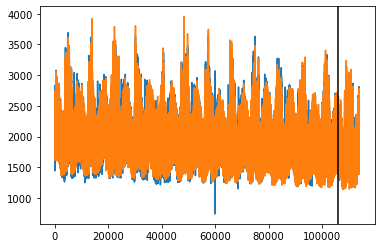

k = 4


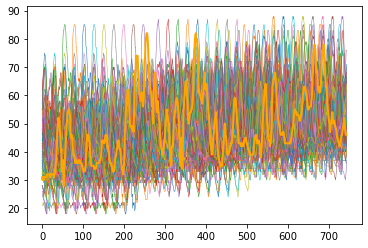

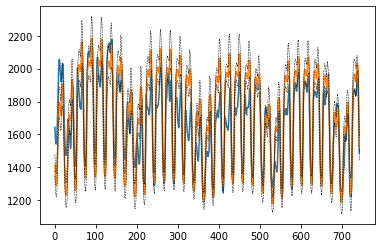

{'WCMASS': 42.45253201560834}
2006-03-10 00:00:00
WCMASS


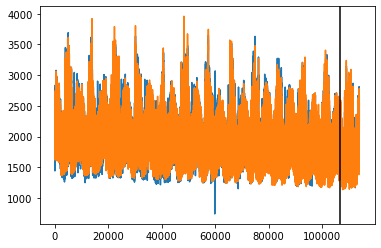

k = 4


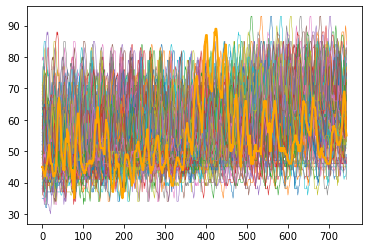

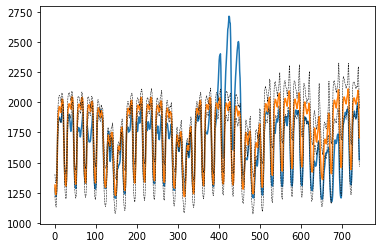

{'WCMASS': 50.69083109785665}
2006-04-10 00:00:00
WCMASS


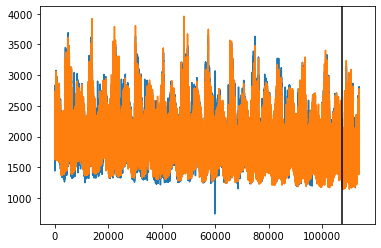

k = 4


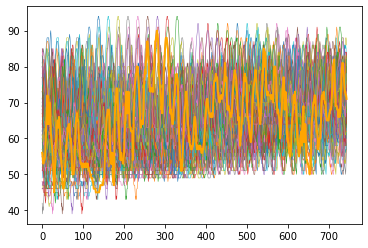

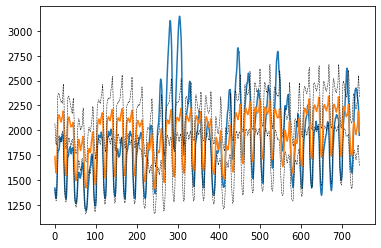

{'WCMASS': 86.00750312564969}
2006-05-10 00:00:00
WCMASS


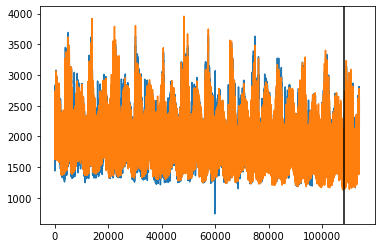

k = 4


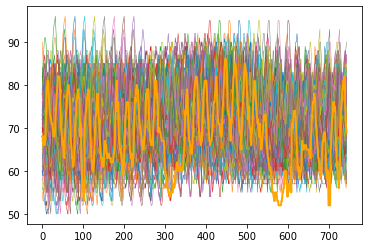

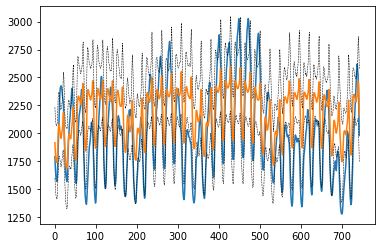

{'WCMASS': 100.67847563434691}
2006-06-10 00:00:00
WCMASS


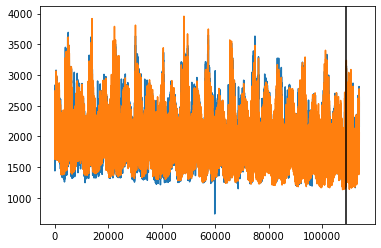

k = 4


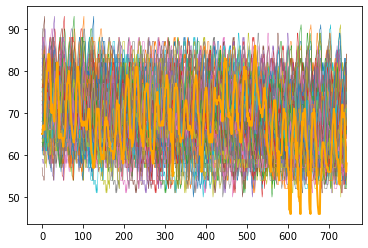

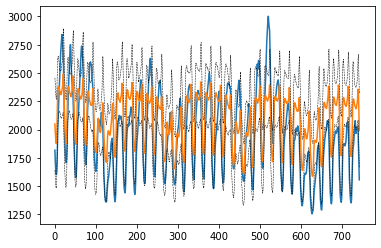

{'WCMASS': 80.5091126365544}
2006-07-11 00:00:00
WCMASS


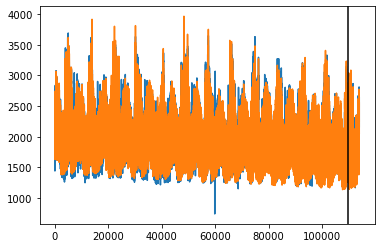

k = 4


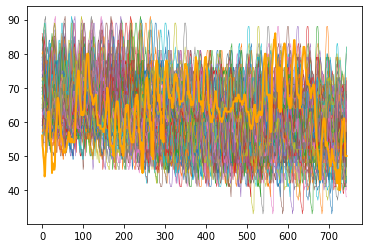

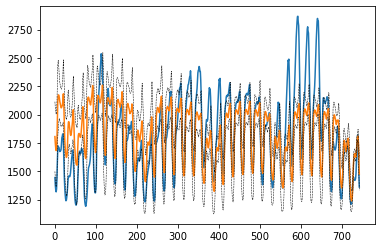

{'WCMASS': 80.94143528985276}
2006-08-10 00:00:00
WCMASS


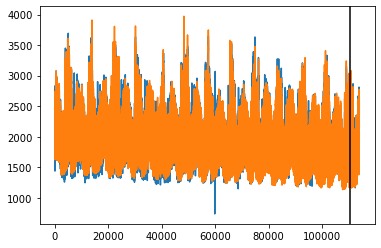

k = 4


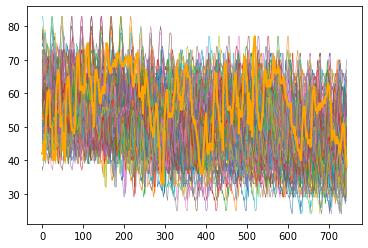

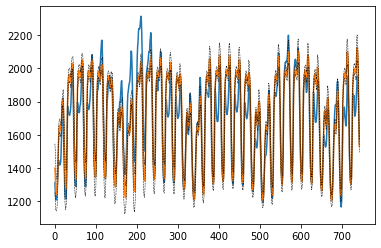

{'WCMASS': 38.42498014970615}
2006-09-10 00:00:00
WCMASS


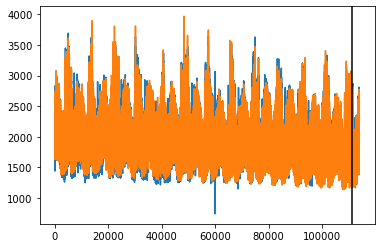

k = 4


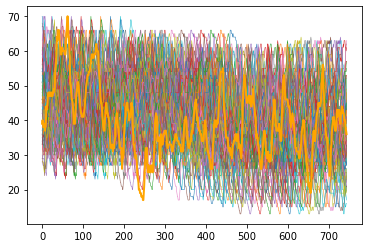

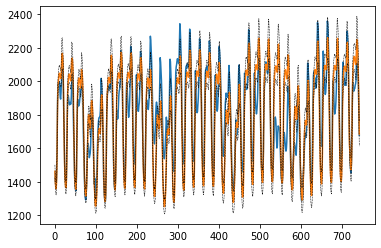

{'WCMASS': 44.71414231081475}
2006-10-10 00:00:00
WCMASS


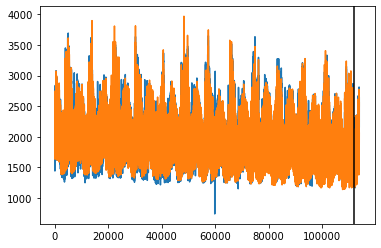

k = 4


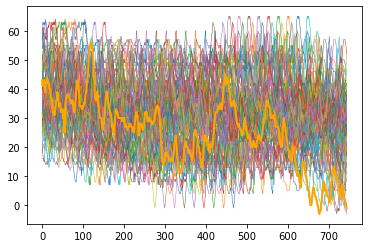

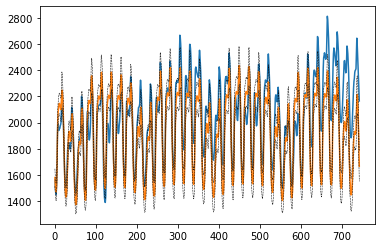

{'WCMASS': 67.19925503863574}
NEMASSBOST
2005-11-10 00:00:00
NEMASSBOST


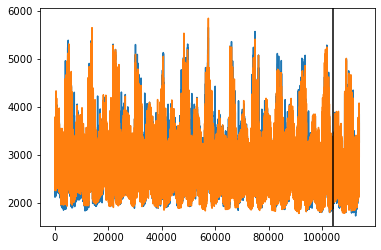

k = 4


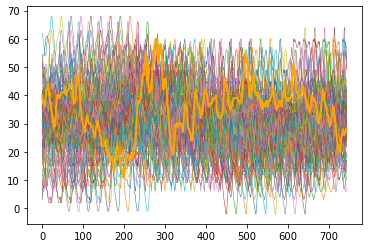

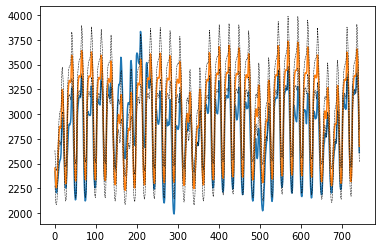

{'NEMASSBOST': 88.28400830509639}
2005-12-11 00:00:00
NEMASSBOST


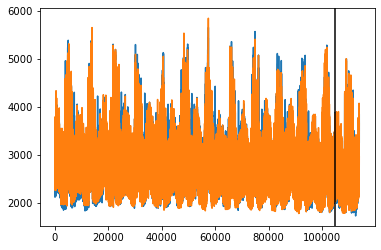

k = 4


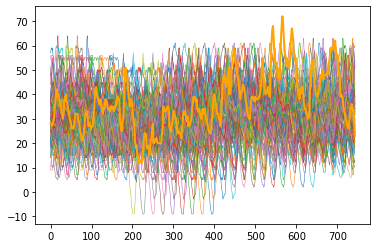

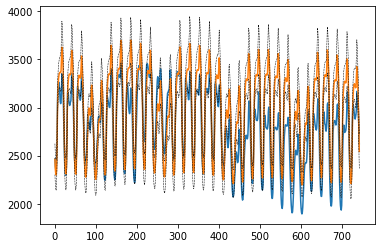

{'NEMASSBOST': 94.67720593128385}
2006-01-08 00:00:00
NEMASSBOST


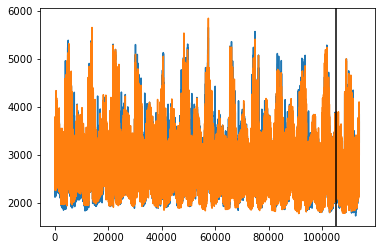

k = 4


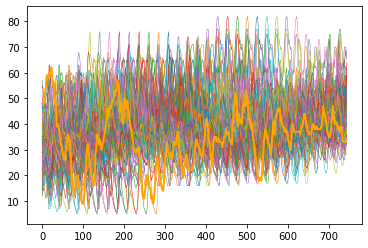

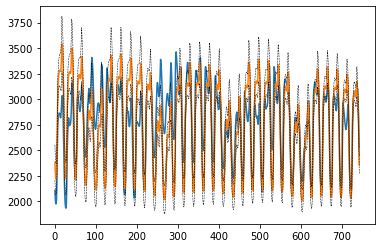

{'NEMASSBOST': 81.41305033918194}
2006-02-08 00:00:00
NEMASSBOST


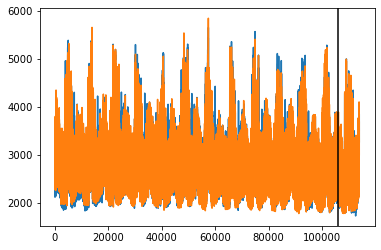

k = 4


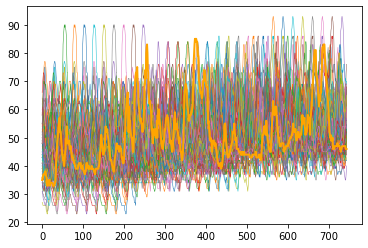

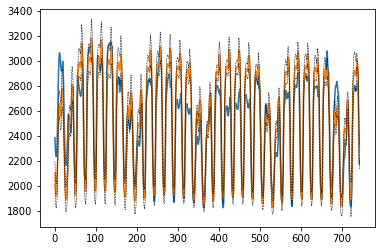

{'NEMASSBOST': 50.95528569711122}
2006-03-10 00:00:00
NEMASSBOST


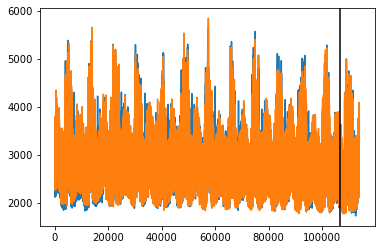

k = 4


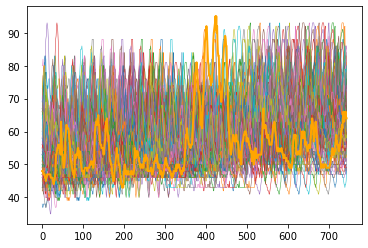

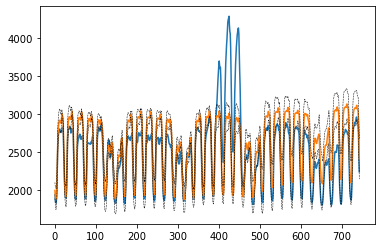

{'NEMASSBOST': 85.04336878408581}
2006-04-10 00:00:00
NEMASSBOST


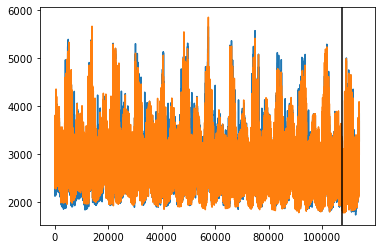

k = 4


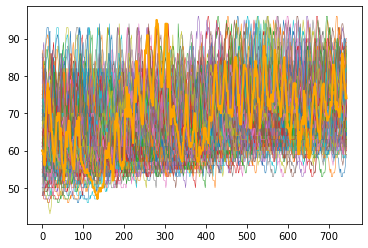

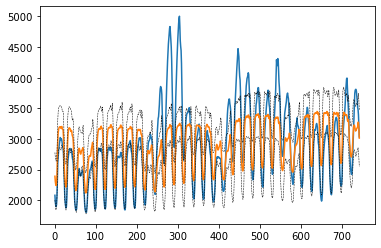

{'NEMASSBOST': 138.0584119857796}
2006-05-10 00:00:00
NEMASSBOST


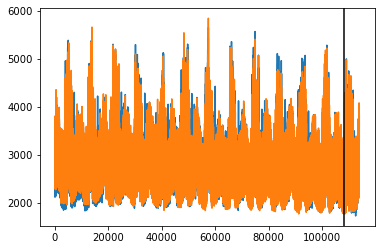

k = 4


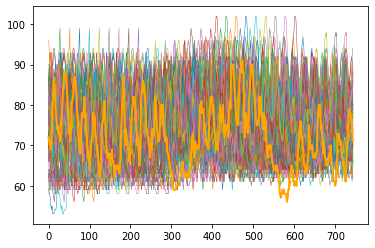

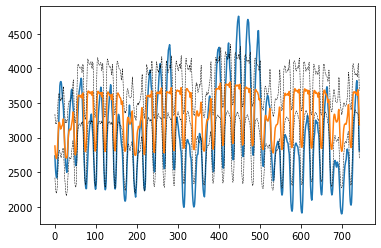

{'NEMASSBOST': 168.44002933470247}
2006-06-10 00:00:00
NEMASSBOST


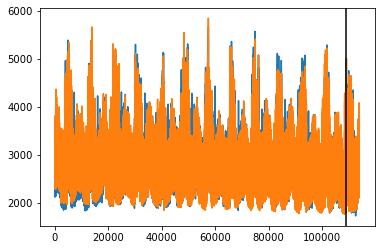

k = 4


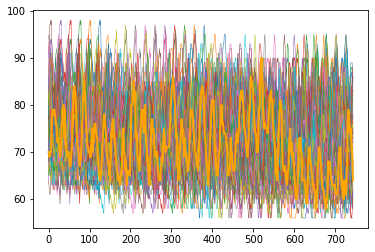

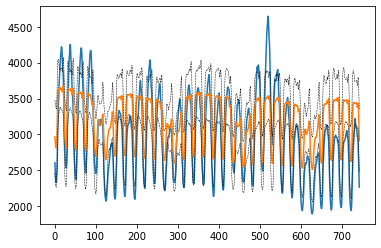

{'NEMASSBOST': 123.97125193175056}
2006-07-11 00:00:00
NEMASSBOST


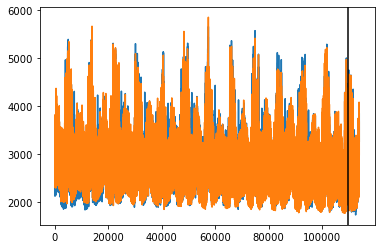

k = 4


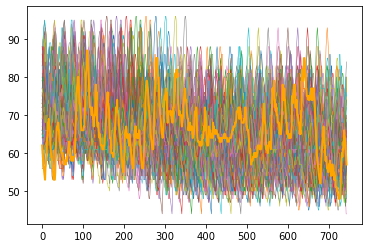

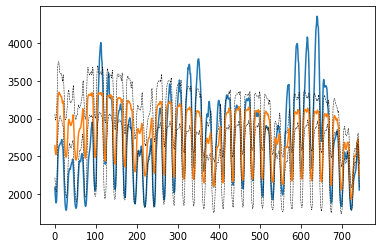

{'NEMASSBOST': 118.30359196993035}
2006-08-10 00:00:00
NEMASSBOST


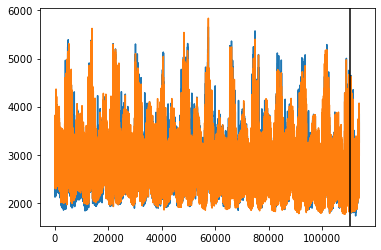

k = 4


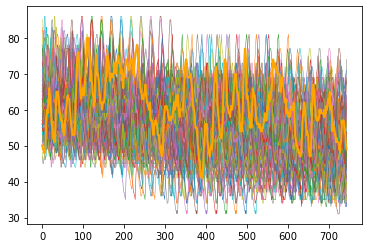

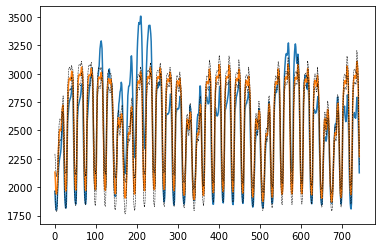

{'NEMASSBOST': 62.00726993038885}
2006-09-10 00:00:00
NEMASSBOST


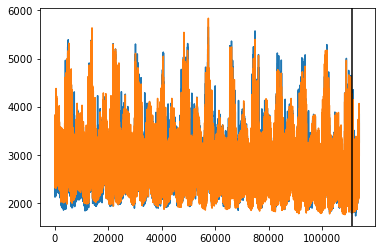

k = 4


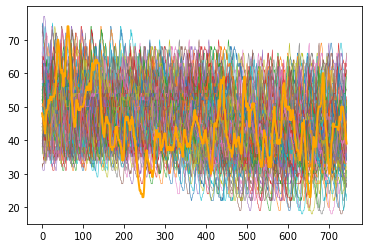

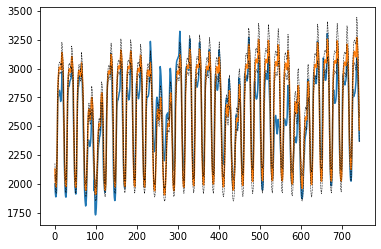

{'NEMASSBOST': 57.393019220601026}
2006-10-10 00:00:00
NEMASSBOST


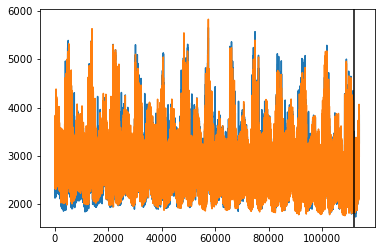

k = 4


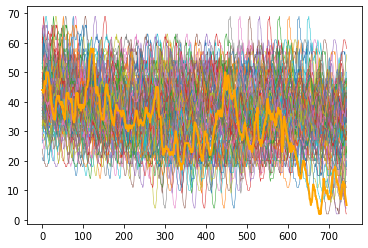

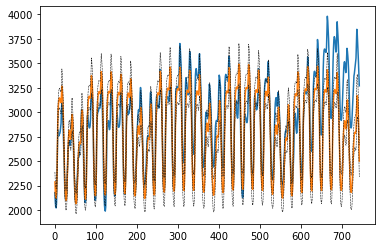

{'NEMASSBOST': 84.96971745420062}
{'ISONE CA': [408.1548293845738, 443.1518695974567, 439.66939319315935, 264.14482297987814, 357.8824069864209, 652.7803806105694, 851.3321358299631, 685.6930050502453, 584.6976079813953, 296.4271424798559, 292.90646286317485, 440.8176836769127], 'ME': [29.233566587803818, 26.692837201950127, 31.045516168685168, 20.790036046341186, 18.163493870926562, 30.590284418401865, 41.3473367044603, 35.175271634429826, 26.598326639268127, 30.981391832060034, 28.27655424271355, 36.7768090390556], 'RI': [24.87647368189112, 28.17349475772855, 26.425418452213048, 14.92165068608465, 22.61568627317137, 49.263655213514994, 68.07470007050351, 54.367698802281254, 44.70689040350833, 21.07133479470931, 16.10131745929902, 24.340919746820667], 'VT': [23.063410324102776, 17.33091738968048, 24.951993825685896, 21.211305470103238, 19.116892372899315, 20.730293417607, 23.976316094198975, 23.619663117394254, 23.609767956495705, 20.106963729026692, 17.959219892885216, 22.05646769711

In [11]:
test_start_dates = np.array(list(pd.Timestamp(f"2017-{month_idx + 1}-01 00:00:00") for month_idx in range(12)))
train_end_dates = test_start_dates - delay_delta
train_start_dates = list(end_date.replace(year=end_date.year - 11) for end_date in train_end_dates)
vanilla_losses = dict()
for zone_name in zones:
    print("\n\nZONE:", zone_name)
    vanilla_losses[zone_name] = []
    for i, start_date in enumerate(train_start_dates):
        print("\ntesting on ", test_start_dates[i])
        loss = vanilla_benchmark.get_lossesGEFCom(11, 31 * 24, start_date=start_date, zones=[zone_name],
                              delay_days=delay_delta.days, plot=True)[zone_name]
        vanilla_losses[zone_name].append(loss)
print(vanilla_losses)

In [12]:
new = pd.DataFrame(vanilla_losses)
old = pd.DataFrame({'ISONE CA': [396.80724510688697, 409.13201995070347, 373.5736890307723, 216.56437790241225, 358.0472823830687, 560.1433664017665, 637.5725866361081, 492.79067317304356, 546.8176847562634, 297.1252275578539, 275.4528671832223, 444.53341320939836], 'ME': [28.415283347371133, 24.285066419107142, 25.37834533302525, 18.13171850954474, 17.12675354981821, 27.557409519537448, 32.32882313921198, 25.501681740200993, 25.138356572177823, 30.640453870158066, 28.221124439927713, 37.533138489271415], 'RI': [23.931533993033284, 25.973438764561777, 22.776366882964062, 12.621410383342402, 22.181188292396556, 40.184768197183345, 49.48678211986186, 36.72894705010676, 39.95675449533233, 21.063445636986287, 14.912208747014711, 24.64585923060675], 'VT': [22.959252952672337, 16.490437964962375, 22.68469889021351, 18.741538290194963, 19.900982951282597, 22.81754514086226, 26.19064367998076, 25.560840058298247, 25.55991251884145, 20.040321972003404, 16.8536080672572, 22.35610761956649], 'CT': [109.64124058305158, 113.07040798789514, 107.38870119070785, 55.777437825515435, 101.03837552526281, 162.00682483760525, 173.35265777211984, 140.072119223232, 160.19797391920127, 78.18906383206543, 68.55768780106516, 120.56417273928882], 'NH': [33.9566984279856, 31.818734198224107, 32.15972951509543, 17.236332582516514, 27.814300177731646, 50.64747492756817, 51.39273428015884, 41.86378787088924, 47.05641423270474, 26.877181409554677, 27.0372036748085, 39.806307014459755], 'SEMASS': [48.90390935768163, 56.54383712644797, 50.15547131810702, 36.40889653873159, 48.89969977379653, 72.7853711593881, 100.11782307875013, 75.12822738768183, 68.04345188830617, 42.58982433989457, 48.946806193926605, 57.67216403555557], 'WCMASS': [53.23794920206294, 64.65842258079017, 56.82426273355672, 36.61426014612751, 52.405287384306725, 81.1840835772649, 85.92830148410067, 69.6434522479204, 80.61643713232905, 38.368808201219515, 42.55658871427208, 67.69004686901725], 'NEMASSBOST': [86.69236536323379, 90.66554047152805, 73.38166974932938, 47.5049015396934, 86.78835895773342, 129.85896663226688, 151.5238984858736, 106.00765062100191, 115.06574765310403, 62.2036994548293, 55.525087584704806, 87.71579116908799]})

In [18]:
rel = (1 - (old / new)) * 100
rel

,ISONE CA,ME,RI,VT,CT,NH,SEMASS,WCMASS,NEMASSBOST
0,2.780216,2.799122,3.798527,0.451613,2.594157,4.979874,4.484336,1.889849,1.802867
1,7.676793,9.020288,7.808957,4.849596,9.267278,10.637512,8.710403,5.758924,4.237203
2,15.033046,18.254394,13.808870,9.086628,13.934926,17.782662,15.867660,12.125830,9.864979
3,18.013014,12.786498,15.415455,11.643636,19.277541,20.546325,16.446027,13.752470,6.771396
4,-0.046070,5.707824,1.921224,-4.101559,-0.067685,5.748344,-2.518092,-3.382182,-2.051883
5,14.191146,9.914504,18.429179,-10.068607,17.961228,17.392199,13.110271,5.608138,5.939113
6,25.108831,21.811595,27.305178,-9.235479,32.723525,31.838419,18.611123,14.650772,10.042821
7,28.132463,27.501109,32.443440,-8.218479,31.599870,33.384887,24.526005,13.496187,14.490135
8,6.478549,5.488955,10.625064,-8.259906,8.364490,7.648030,4.969933,0.401523,2.736894
9,-0.235500,1.100460,0.037440,0.331436,-1.294399,3.968859,0.344982,0.146186,-0.316785
